**Community detection**

## Utils

In [ ]:
!pip install python-louvain
!pip install scikit-network

In [1]:
import networkx as nx
from networkx import edge_betweenness_centrality as betweenness
from networkx.algorithms import community
from community import community_louvain
from sknetwork.hierarchy import Paris, cut_straight, dasgupta_score, tree_sampling_divergence
from sknetwork.visualization import svg_graph, svg_dendrogram
from sknetwork.hierarchy.postprocess import cut_straight

import pandas as pd
import numpy as np
import itertools
from operator import itemgetter
import re


from google.colab import files
from IPython.display import SVG
import matplotlib.pyplot as plt

In [61]:
def network_from_edges(edges):
  dict_edges = {}
  for ind in range(len(edges)):
    if edges.iloc[ind,2] > 10:
      dict_edges[(edges.iloc[ind,0], edges.iloc[ind,1])] = edges.iloc[ind,2]
  net = pd.DataFrame.from_dict(dict_edges,orient='index')
  net.columns = ["weight"]
  net.sort_values(by="weight",inplace=True, ascending=False)
  return dict_edges, net


def get_graph(network):
  G = nx.Graph()
  for edge in network:
      #we can filter edges by weight by uncommenting the next line and setting desired weight threshold
      G.add_edge(edge[0], edge[1], weight=network[edge])
  
  #G.add_weighted_edges_from(up_weighted, weight='weight')
  return G


def extract_text(df):       #extract the text from the tweets and RT
                            #works ONLY on .csv file
    list_strings = []
    for index in range(len(df)):
        #print(index)
        text = df.loc[index]['text']                          #if it is nor trucated nor a RT  i take "text"
        string = -1
        if (df.loc[index,"truncated"] == True):                 #if it is trucated I take "extended_tweet"
            string = df.loc[index,"extended_tweet"]
        if type(df.loc[index,"retweeted_status"]) != float:     #if it is a RT I take retweeted_status
            string = df.loc[index,"retweeted_status"]
        if type(string) == str :
            if(re.search('full_text\':(.+?)https',string) != None):     #if I find "full_text"
                s = re.search('full_text\':(.+?)https',string).group(1)
            if(re.search('text\':(.+?)https',string)!= None):
                s = re.search('text\':(.+?)https',string).group(1)
            else:  #here then one should remove the http
                if (re.search('full_text\':\s\'(.+?)\'',string)!=None) :
                    s=re.search('full_text\':\s\'(.+?)\'',string).group(1)  
                if (re.search('\{\\\'full_text\\\':\s(.+?)\"',string)!=None) : 
                    re.search('\{\\\'full_text\\\':\s(.+?)\"',string).group(1)
            
            list_strings.append(s)
            #print(s)         
        else:
            list_strings.append(text)
            #print(text)
      

    return list_strings


def frequency_dictionary(df):
  unique_words = {}

  for row in df:
    for word in row.split():
      #if the word is encountered for the first time add to dict as key and set its value to 0
      unique_words.setdefault(word,0)
      #increase the value (i.e the count) of the word by 1 every time it is encountered
      unique_words[word] += 1

  return unique_words


def adj_matrix(node_list, edge_list):   

  words = sorted(list(node_list['Id']))

  A = pd.DataFrame(np.zeros((len(words),len(words))), columns = words, index = words)
  print('A shape: ', A.shape)
  for row in range(len(edge_list)):
    if row%1000==0:
      print(str(round(row/1000)) + '/' + str(round(len(edge_list)/1000)))
    word1 = edge_list.iloc[row, 0]
    word2 = edge_list.iloc[row, 1]
    weight = edge_list.iloc[row, 2]
    A[word1, word2] = weight
    A[word2, word1] = weight
  print('A shape: ', A.shape)
  return A

def threshold(vector,threshold):

  l = [(el,vector[el]) for el in vector if vector[el] >= threshold ]

  return pd.DataFrame(l)

def threshold_reverse(vector,threshold):

  l = [(el,vector[el]) for el in vector if vector[el] < threshold ]

  return pd.DataFrame(l)

In [3]:
def community_check(community, dict_1, dict_2, G_1, G_2, thr):
  sum_1 = 0
  sum_2 = 0
  sum_12 = 0
  for key in community:
    if (key in list(dict_1.keys())) and (key in list(dict_2.keys())):
      if dict_1[key] / sum(list(dict_1.values())) - dict_2[key] / sum(list(dict_2.values())) > thr:
        sum_1 += 1
      elif dict_1[key] / sum(list(dict_1.values())) - dict_2[key] / sum(list(dict_2.values())) < -thr:
        sum_2 += 1  
      else:
        sum_12 += 1 
    elif key in list(G_1.nodes()):
      sum_1 += 1
    elif key in list(G_2.nodes()):
      sum_2 += 1
  return sum_1, sum_2, sum_12

In [4]:
# Functions for measuring the quality of a partition (into communities).

def compute_metrics(G, partition):

  # Returns the coverage of a partition.
  coverage = community.coverage(G, partition)

  # Returns the coverage and performance of a partition of G.
  quality = community.partition_quality(G, partition)

  performance = community.performance(G, partition)

  # Returns the modularity of the given partition of the graph.
  modularity = community.modularity(G, partition)

  print("Coverage: ", coverage)
  # print("Quality: ", quality) # Coverage and performance
  print("Performance: ", performance)
  print("Modularity: ", modularity)

  return coverage, quality, performance, modularity


In [5]:
def community_layout(g, partition):
    """
    Compute the layout for a modular graph.


    Arguments:
    ----------
    g -- networkx.Graph or networkx.DiGraph instance
        graph to plot

    partition -- dict mapping int node -> int community
        graph partitions


    Returns:
    --------
    pos -- dict mapping int node -> (float x, float y)
        node positions

    """

    pos_communities = _position_communities(g, partition, scale=3.)

    pos_nodes = _position_nodes(g, partition, scale=2.)

    # combine positions
    pos = dict()
    for node in g.nodes():
        pos[node] = pos_communities[node] + pos_nodes[node]

    return pos

def _position_communities(g, partition, **kwargs):

    # create a weighted graph, in which each node corresponds to a community,
    # and each edge weight to the number of edges between communities
    between_community_edges = _find_between_community_edges(g, partition)

    communities = set(partition.values())
    hypergraph = nx.DiGraph()
    hypergraph.add_nodes_from(communities)
    for (ci, cj), edges in between_community_edges.items():
        hypergraph.add_edge(ci, cj, weight=len(edges))

    # find layout for communities
    pos_communities = nx.circular_layout(hypergraph, **kwargs)

    # set node positions to position of community
    pos = dict()
    for node, community in partition.items():
        pos[node] = pos_communities[community]

    return pos

def _find_between_community_edges(g, partition):

    edges = dict()

    for (ni, nj) in g.edges():
        ci = partition[ni]
        cj = partition[nj]

        if ci != cj:
            try:
                edges[(ci, cj)] += [(ni, nj)]
            except KeyError:
                edges[(ci, cj)] = [(ni, nj)]

    return edges

def _position_nodes(g, partition, **kwargs):
    """
    Positions nodes within communities.
    """

    communities = dict()
    for node, community in partition.items():
        try:
            communities[community] += [node]
        except KeyError:
            communities[community] = [node]

    pos = dict()
    for ci, nodes in communities.items():
        subgraph = g.subgraph(nodes)
        pos_subgraph = nx.spring_layout(subgraph, **kwargs)
        pos.update(pos_subgraph)

    return pos

# PageRank Networks: inside/outside together

## **All periods**

### Download data

In [155]:
China = pd.read_csv('/content/China.csv')
USA = pd.read_csv('/content/USA.csv',)

edges = pd.read_csv('/content/edgelist_China_USA.csv')
edges_China = pd.read_csv('/content/edgelist_China.csv')
edges_USA = pd.read_csv('/content/edgelist_USA.csv')

text_China = extract_text(China)
text_USA = extract_text(USA)

freq_dict_China = frequency_dictionary(text_China)
freq_dict_China = dict(sorted(freq_dict_China.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

freq_dict_USA = frequency_dictionary(text_USA)
freq_dict_USA = dict(sorted(freq_dict_USA.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

net, net_df = network_from_edges(edges)
net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G = get_graph(net)
nodes = G.nodes()
G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [156]:
print('China&USA:')
print('Nodes: ',len(G.nodes()))
print('Edges: ',len(G.edges()))
print('Is connected: ',nx.is_connected(G))
print()
print('China:')
print('Words: ',len(freq_dict_China))
print()
print('USA:')
print('Words: ',len(freq_dict_USA))

China&USA:
Nodes:  509
Edges:  12061
Is connected:  True

China:
Words:  17019

USA:
Words:  33536


In [160]:
# PageRank for reducing the graph
pr = nx.algorithms.pagerank(G, alpha = 1)
pr = dict(sorted(pr.items(), key=lambda item: item[1],reverse = True))

thr = 0.002
len(threshold(pr,thr))

96

In [161]:
G_reduced = G.copy()
nodes_to_delete = list(threshold_reverse(pr,thr)[0])
for n in nodes_to_delete:
    G_reduced.remove_node(n)

nx.is_connected(G_reduced)

True

### Bipartition
Partition a graph into two blocks using the Kernighan–Lin algorithm.

In [96]:
community_bipart = community.kernighan_lin_bisection(G,weight='weight')

In [97]:
print(community_bipart[0])
print(community_bipart[1])

{'already', 'joe', 'holiday', 'food', 'talk', 'order', 'experimental', 'adviser', 'citizen', 'crisis', 'seven', 'service', 'past', 'hard', 'meet', 'mark', 'foreign', 'hope', 'development', 'season', 'korea', 'force', 'link', 'region', 'several', 'within', 'read', 'push', 'export', 'side', 'infectious', 'likely', 'decline', 'stop', 'deliver', 'family', 'california', 'extend', 'critical', 'possible', 'watch', 'ask', 'british', 'severe', 'arrive', 'breaking', 'growth', 'batch', 'deadly', 'join', 'democratic', 'area', 'affect', 'term', 'post', 'line', 'agency', 'aid', 'game', 'loss', 'try', 'slow', 'life', 'donate', 'problem', 'air', 'boost', 'italy', 'committee', 'employee', 'stock', 'urge', 'visit', 'major', 'want', 'small', 'germany', 'canada', 'community', 'court', 'full', 'restaurant', 'experience', 'poll', 'add', 'business', 'stay', 'department', 'former', 'wear', 'federal', 'ahead', 'special', 'military', 'rule', 'secretary', 'step', 'recent', 'man', 'person', 'exclusive', 'governor

In [98]:
threshold = 0.00001
sum_China_0, sum_USA_0, sum_China_USA_0 = community_check(community_bipart[0], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
sum_China_1, sum_USA_1, sum_China_USA_1 = community_check(community_bipart[1], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)

In [99]:
print('First community:')
print('China: ', round(100 * sum_China_0 / len(community_bipart[0])),'%')
print('USA: ', round(100 * sum_USA_0 / len(community_bipart[0])),'%')
print('China&USA: ', round(100 * sum_China_USA_0 / len(community_bipart[0])),'%')
print()
print('China: ', round(100 * sum_China_1 / len(community_bipart[1])),'%')
print('USA: ', round(100 * sum_USA_1 / len(community_bipart[1])),'%')
print('China&USA: ', round(100 * sum_China_USA_1 / len(community_bipart[1])),'%')

First community:
China:  30 %
USA:  62 %
China&USA:  8 %

China:  39 %
USA:  53 %
China&USA:  8 %


Nodes seem to be important both for China and USA: bipartition doesn't detect the differences between them.

**Metrics**

In [101]:
_ = compute_metrics(G, community_bipart)

Coverage:  0.6865931514799768
Performance:  0.5357966059743514
Modularity:  -0.005676926619908531


### Modularity-based communities
Find communities in G using greedy modularity maximization.

In [15]:
community_mod = community.greedy_modularity_communities(G, n_communities=2, weight='weight')
# communities_naive_mod = community.naive_greedy_modularity_communities(G)

In [16]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['already', 'holiday', 'order', 'economy', 'treat', 'citizen', 'crisis', 'central', 'service', 'continue', 'passenger', 'foreign', 'fight', 'development', 'recover', 'force', 'read', 'amid', 'stop', 'family', 'effort', 'critical', 'watch', 'growth', 'deadly', 'join', 'affect', 'outside', 'close', 'line', 'business', 'loss', 'try', 'air', 'life', 'update', 'employee', 'stock', 'city', 'visit', 'major', 'community', 'full', 'restaurant', 'travel', 'year', 'control', 'stay', 'department', 'die', 'fear', 'special', 'step', 'recent', 'man', 'help', 'many', 'market', 'win', 'prevent', 'place', 'call', 'like', 'china', 'keep', 'evacuate', 'support', 'long', 'become', 'hong', 'great', 'demand', 'large', 'infect', 'global', 'cause', 'financial', 'live', 'start', 'care', 'human', 'express', 'battle', 'look', 'treatment', 'industry', 'coronavirus', 'send', 'lead', 'center', 'measure', 'japan', 'avoid', 'world', 'work', 'cruise', 'late', 'people', 'billion', 'suspend', 'fund', 'video', 'thousand',

In [17]:
threshold = 0.00001
for i in range(len(community_mod_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_mod_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_mod_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_mod_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_mod_list[i])),'%')
  print()

Community:  0
China:  43 %
USA:  48 %
China&USA:  9 %

Community:  1
China:  24 %
USA:  66 %
China&USA:  10 %

Community:  2
China:  24 %
USA:  71 %
China&USA:  6 %

Community:  3
China:  47 %
USA:  48 %
China&USA:  5 %

Community:  4
China:  75 %
USA:  0 %
China&USA:  25 %



**Metrics**

In [18]:
_ = compute_metrics(G, community_mod_list)

Coverage:  0.38951994030345743
Performance:  0.7186160914561515
Modularity:  0.18304543001329376


In [20]:
colors = list(G.nodes)
i = 0
dict_nodes = {}
for node in colors:
  if node in community_mod_list[0]:
    colors[i] = 'violet'
    dict_nodes[node] = 0
  if node in community_mod_list[1]:
    colors[i] = 'lightcoral'
    dict_nodes[node] = 1
  if node in community_mod_list[2]:
    colors[i] = 'lawngreen'
    dict_nodes[node] = 2
  if node in community_mod_list[3]:
    colors[i] = 'cyan'
    dict_nodes[node] = 3
  if node in community_mod_list[4]:
    colors[i] = 'dodgerblue'
    dict_nodes[node] = 4
  i += 1

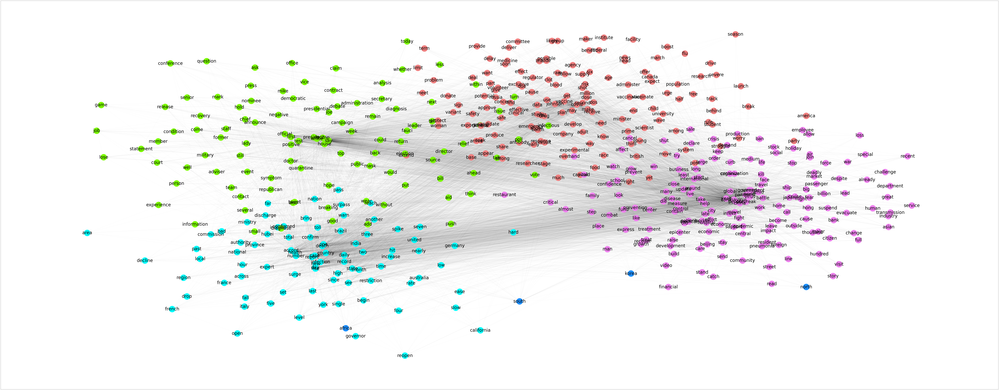

In [21]:
pos = community_layout(G, dict_nodes)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Louvain Community Detection
Find the best partition of a graph using the Louvain Community Detection Algorithm.

In [22]:
# communities_louvain = community.louvain.louvain_communities(G)
# partitions_louvain = community.louvain.louvain_partitions(G)

community_louv = community_louvain.best_partition(G,weight='weight')

# modularity_louvain = community.modularity(communities_louvain, G) # ERROR: not a partition
# print("The modularity Q based on networkx is {}".format(modularity_louvain))

In [23]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['talk', 'president', 'trump', 'relief', 'house', 'aid', 'secretary', 'first', 'test', 'positive', 'person', 'announce', 'team', 'office', 'chief', 'official', 'hold', 'week', 'come', 'diagnose', 'leader', 'also', 'press', 'conference', 'put', 'former', 'symptom', 'quarantine', 'statement', 'top', 'recovery', 'follow', 'tell', 'vice', 'good', 'return', 'news', 'staff', 'military', 'release', 'remain', 'senior', 'analysis', 'claim', 'administration', 'campaign', 'white', 'election', 'contact', 'negative', 'hope', 'contract', 'several', 'mark', 'without', 'diagnosis', 'next', 'lady', 'presidential', 'debate', 'tweet', 'event', 'vote', 'mike', 'adviser', 'joe', 'court', 'nominee', 'republican', 'well', 'democratic', 'breaking', 'member', 'ahead', 'game', 'bill', 'small']
['hospital', 'critical', 'condition', 'treatment', 'patient', 'discharge', 'recover', 'doctor', 'video', 'build', 'facility', 'treat', 'care']
['deal', 'say', 'covid', 'vaccine', 'university', 'student', 'data', 'among', 

In [24]:
threshold = 0.00001
for i in range(len(community_louvain_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_louvain_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_louvain_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_louvain_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_louvain_list[i])),'%')
  print()

Community:  0
China:  26 %
USA:  68 %
China&USA:  6 %

Community:  1
China:  77 %
USA:  23 %
China&USA:  0 %

Community:  2
China:  23 %
USA:  68 %
China&USA:  10 %

Community:  3
China:  46 %
USA:  50 %
China&USA:  4 %

Community:  4
China:  39 %
USA:  51 %
China&USA:  10 %

Community:  5
China:  88 %
USA:  0 %
China&USA:  12 %



**Metrics**

In [25]:
_ = compute_metrics(G, community_louvain_list)

Coverage:  0.38197496061686426
Performance:  0.7167674767569574
Modularity:  0.1839528758286053


In [26]:
colors = list(community_louv.values())

colors[:] = [x if x != 0 else 'violet' for x in colors]
colors[:] = [x if x != 1 else 'dodgerblue' for x in colors]
colors[:] = [x if x != 2 else 'lawngreen' for x in colors]
colors[:] = [x if x != 3 else 'pink' for x in colors]
colors[:] = [x if x != 4 else 'lightcoral' for x in colors]
colors[:] = [x if x != 5 else 'cyan' for x in colors]

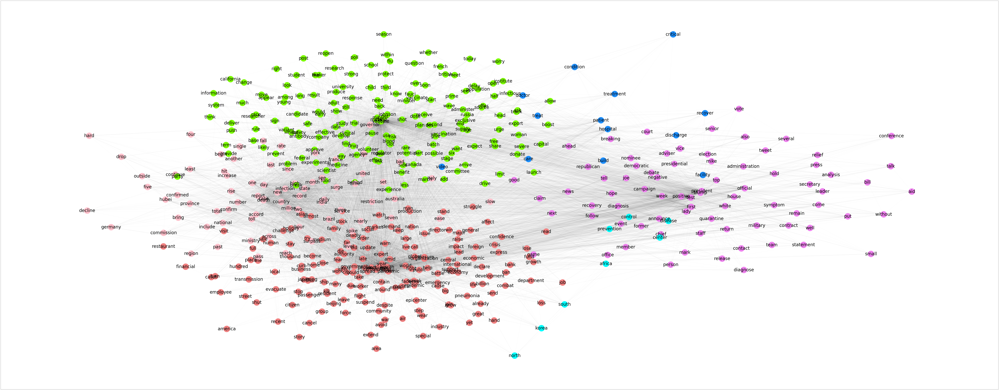

In [27]:
pos = community_layout(G, community_louv)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Dendogram

In [162]:
paris = Paris()
adjacency = nx.convert_matrix.to_numpy_array(G_reduced, nodelist = list(G_reduced.nodes))
dendrogram = paris.fit_transform(adjacency)

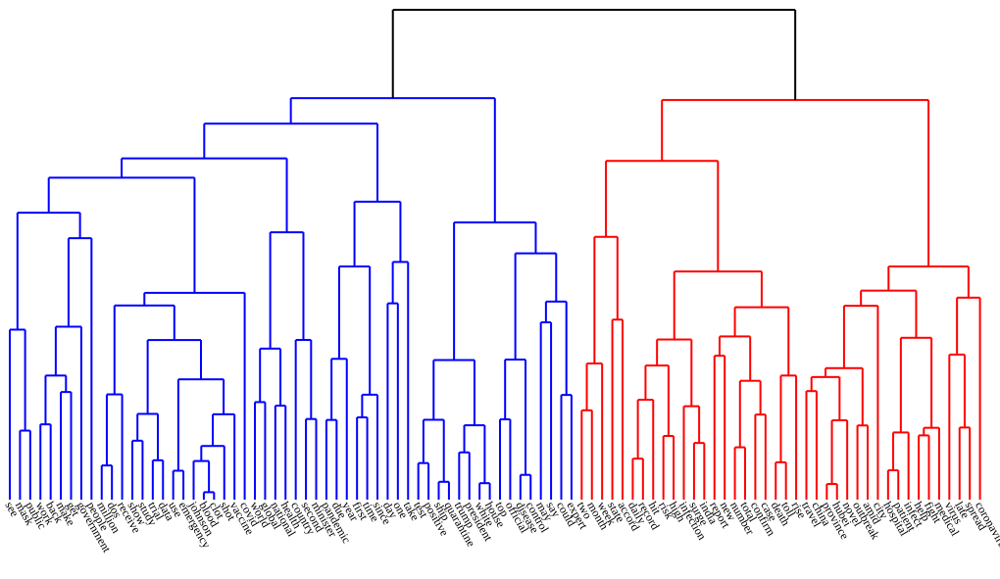

In [163]:
names = list(G_reduced.nodes)
image = svg_dendrogram(dendrogram, names, n_clusters=2, rotate=False,width=1000,height=500,filename='community_dendogram2_all_periods')
SVG(image)

**Metrics**

In [79]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=2, return_dendrogram=False))

community_dend = [[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [76]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.5369375419744795
Performance:  0.5394736842105263
Modularity:  0.11809737915987065


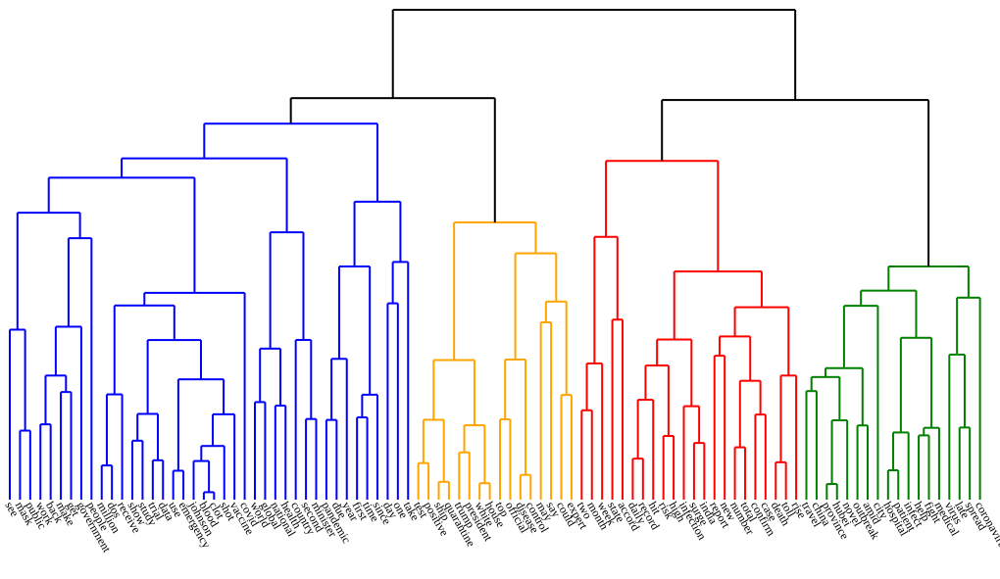

In [164]:
image = svg_dendrogram(dendrogram, names, n_clusters=4, rotate=False,width=1000,height=500,filename='community_dendogram4_all_periods')
SVG(image)

**Metrics**

In [81]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=4, return_dendrogram=False))

community_dend = [[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [82]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.3213566151779718
Performance:  0.4850877192982456
Modularity:  0.13422247552561933


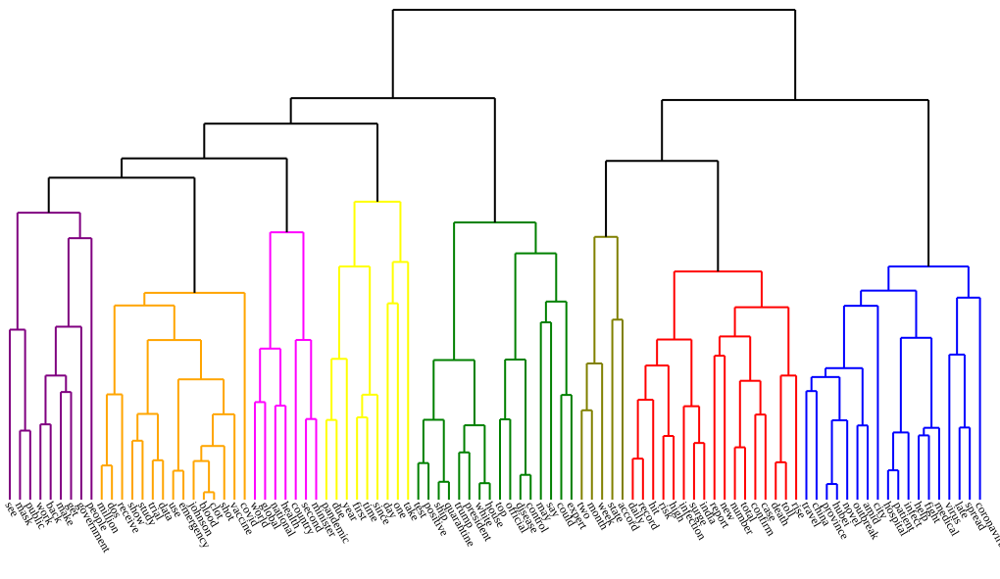

In [165]:
image = svg_dendrogram(dendrogram, names, n_clusters=8, rotate=False,width=1000,height=500,filename='community_dendogram8_all_periods')
SVG(image)

**Metrics**

In [84]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=8, return_dendrogram=False))

community_dend = [[],[],[],[],[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [85]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.1668905305574211
Performance:  0.4296052631578947
Modularity:  0.12662026346890476


### Girvan_Newman: not working!

In [ ]:
community_gn = community.girvan_newman(G)
k = 2
i = 1
for comm in itertools.islice(community_gn, k):
  if i == 2:
    for x in range(len(comm)):
      print(sorted(comm[x]))
  i += 1

['accord', 'across', 'add', 'administer', 'administration', 'adult', 'adviser', 'affect', 'africa', 'age', 'agency', 'ahead', 'aid', 'air', 'allow', 'almost', 'already', 'also', 'amid', 'among', 'analysis', 'announce', 'another', 'antibody', 'appear', 'approve', 'area', 'around', 'arrive', 'asian', 'ask', 'australia', 'authority', 'avoid', 'back', 'bad', 'ban', 'bank', 'base', 'batch', 'battle', 'become', 'begin', 'behind', 'beijing', 'benefit', 'big', 'bill', 'billion', 'blood', 'boost', 'brazil', 'break', 'breaking', 'bring', 'british', 'build', 'business', 'california', 'call', 'campaign', 'canada', 'cancel', 'candidate', 'capital', 'care', 'case', 'catch', 'cause', 'center', 'central', 'challenge', 'change', 'chief', 'child', 'china', 'citizen', 'city', 'claim', 'clinical', 'close', 'clot', 'combat', 'come', 'commission', 'committee', 'community', 'company', 'concern', 'condition', 'confidence', 'confirm', 'confirmed', 'contact', 'contain', 'continue', 'contract', 'control', 'coron

In [ ]:
# VERY HEAVY COMPUTATION
def most_central_edge(G):
  centrality = betweenness(G, weight="weight")
  return max(centrality, key=centrality.get)

community_gn_centrality = community.girvan_newman(G, most_valuable_edge=most_central_edge)
tuple(print(sorted(c)) for c in next(community_gn_centrality))

In [ ]:
def heaviest(G):
  u, v, w = max(G.edges(data="weight"), key=itemgetter(2))
  return (u, v)

community_gn_heaviest = community.girvan_newman(G, most_valuable_edge=heaviest)
tuple(print(sorted(c)) for c in next(community_gn_heaviest))

['accord', 'across', 'add', 'administer', 'administration', 'adult', 'adviser', 'affect', 'africa', 'age', 'agency', 'ahead', 'aid', 'air', 'allow', 'almost', 'already', 'also', 'america', 'amid', 'among', 'analysis', 'announce', 'another', 'antibody', 'appear', 'approve', 'area', 'around', 'arrive', 'asian', 'ask', 'australia', 'authority', 'avoid', 'back', 'bad', 'ban', 'bank', 'base', 'batch', 'battle', 'become', 'begin', 'behind', 'beijing', 'benefit', 'big', 'bill', 'billion', 'blood', 'boost', 'brazil', 'break', 'breaking', 'bring', 'british', 'build', 'business', 'california', 'call', 'campaign', 'canada', 'cancel', 'candidate', 'capital', 'care', 'case', 'catch', 'cause', 'center', 'central', 'challenge', 'change', 'chief', 'child', 'china', 'citizen', 'city', 'claim', 'clinical', 'close', 'clot', 'combat', 'come', 'commission', 'committee', 'community', 'company', 'concern', 'condition', 'confidence', 'confirm', 'confirmed', 'contact', 'contain', 'continue', 'contract', 'contr

(None, None)

### Clique percolation: heavy!

In [ ]:
cliques = nx.find_cliques(G)

In [ ]:
k = 5
community_clique = community.k_clique_communities(G, k, cliques)

In [ ]:
c = next(community_clique)

## **JanFeb2020**

### Download data

In [102]:
period = '_JanFeb2020'
China = pd.read_csv('/content/China'+period+'.csv')
USA = pd.read_csv('/content/USA'+period+'.csv',)

edges = pd.read_csv('/content/edgelist_China_USA'+period+'.csv')
edges_China = pd.read_csv('/content/edgelist_China'+period+'.csv')
edges_USA = pd.read_csv('/content/edgelist_USA'+period+'.csv')

text_China = extract_text(China)
text_USA = extract_text(USA)

freq_dict_China = frequency_dictionary(text_China)
freq_dict_China = dict(sorted(freq_dict_China.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

freq_dict_USA = frequency_dictionary(text_USA)
freq_dict_USA = dict(sorted(freq_dict_USA.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

net, net_df = network_from_edges(edges)
net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G = get_graph(net)
nodes = G.nodes()
G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [103]:
print('China&USA:')
print('Nodes: ',len(G.nodes()))
print('Edges: ',len(G.edges()))
print('Is connected: ',nx.is_connected(G))
print()
print('China:')
print('Words: ',len(freq_dict_China))
print()
print('USA:')
print('Words: ',len(freq_dict_USA))

China&USA:
Nodes:  453
Edges:  3271
Is connected:  True

China:
Words:  10263

USA:
Words:  10601


In [111]:
# PageRank for reducing the graph
pr = nx.algorithms.pagerank(G, alpha = 1)
pr = dict(sorted(pr.items(), key=lambda item: item[1],reverse = True))

thr = 0.002
len(threshold(pr,thr))

90

In [112]:
G_reduced = G.copy()
nodes_to_delete = list(threshold_reverse(pr,thr)[0])
for n in nodes_to_delete:
    G_reduced.remove_node(n)

nx.is_connected(G_reduced)

True

### Bipartition
Partition a graph into two blocks using the Kernighan–Lin algorithm.

In [113]:
community_bipart = community.kernighan_lin_bisection(G,weight='weight')

In [114]:
print(community_bipart[0])
print(community_bipart[1])

{'investor', 'daily', 'fall', 'quarter', 'come', 'food', 'talk', 'tokyo', 'order', 'negative', 'sell', 'medic', 'firm', 'service', 'hard', 'model', 'meet', 'still', 'force', 'several', 'carry', 'cough', 'read', 'trial', 'infectious', 'together', 'california', 'extend', 'family', 'also', 'critical', 'possible', 'ask', 'watch', 'baby', 'airport', 'currently', 'respiratory', 'severe', 'arrive', 'growth', 'wash', 'join', 'last', 'affect', 'area', 'wish', 'temporarily', 'line', 'six', 'aid', 'slow', 'try', 'way', 'air', 'life', 'plan', 'restriction', 'urge', 'visit', 'major', 'community', 'surgical', 'animal', 'charter', 'full', 'australia', 'france', 'wear', 'fast', 'special', 'military', 'set', 'nearly', 'part', 'person', 'near', 'many', 'threat', 'mother', 'recently', 'miss', 'source', 'nine', 'place', 'keep', 'news', 'long', 'well', 'tell', 'demand', 'information', 'increase', 'university', 'large', 'much', 'system', 'release', 'evacuee', 'condition', 'strand', 'wall', 'deal', 'recovery

In [115]:
threshold = 0.00001
sum_China_0, sum_USA_0, sum_China_USA_0 = community_check(community_bipart[0], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
sum_China_1, sum_USA_1, sum_China_USA_1 = community_check(community_bipart[1], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)

In [116]:
print('First community:')
print('China: ', round(100 * sum_China_0 / len(community_bipart[0])),'%')
print('USA: ', round(100 * sum_USA_0 / len(community_bipart[0])),'%')
print('China&USA: ', round(100 * sum_China_USA_0 / len(community_bipart[0])),'%')
print()
print('China: ', round(100 * sum_China_1 / len(community_bipart[1])),'%')
print('USA: ', round(100 * sum_USA_1 / len(community_bipart[1])),'%')
print('China&USA: ', round(100 * sum_China_USA_1 / len(community_bipart[1])),'%')

First community:
China:  41 %
USA:  52 %
China&USA:  6 %

China:  46 %
USA:  51 %
China&USA:  3 %


**Metrics**

In [118]:
_ = compute_metrics(G, community_bipart)

Coverage:  0.8098440843778661
Performance:  0.5209029283635156
Modularity:  -8.30157640868026e-05


### Modularity-based communities
Find communities in G using greedy modularity maximization.

In [119]:
community_mod = community.greedy_modularity_communities(G, n_communities=2, weight='weight')
# communities_naive_mod = community.naive_greedy_modularity_communities(G)

In [120]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['united', 'investor', 'fall', 'quarter', 'come', 'food', 'order', 'tokyo', 'economy', 'sell', 'citizen', 'firm', 'hard', 'still', 'korea', 'force', 'several', 'cough', 'back', 'warn', 'trial', 'far', 'infectious', 'family', 'california', 'possible', 'watch', 'respiratory', 'currently', 'airport', 'arrive', 'growth', 'see', 'wash', 'last', 'area', 'temporarily', 'affect', 'drug', 'close', 'line', 'six', 'business', 'slow', 'try', 'level', 'air', 'rate', 'plan', 'stock', 'restriction', 'urge', 'may', 'charter', 'animal', 'travel', 'australia', 'department', 'get', 'wear', 'risk', 'fear', 'military', 'set', 'since', 'nearly', 'part', 'person', 'near', 'hit', 'market', 'recently', 'nine', 'news', 'place', 'source', 'like', 'keep', 'well', 'become', 'demand', 'university', 'much', 'system', 'state', 'evacuee', 'strand', 'wall', 'panic', 'limit', 'finally', 'potential', 'move', 'among', 'south', 'clinical', 'industry', 'coronavirus', 'police', 'woman', 'result', 'illness', 'office', 'run', 

In [121]:
threshold = 0.00001
for i in range(len(community_mod_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_mod_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_mod_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_mod_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_mod_list[i])),'%')
  print()

Community:  0
China:  24 %
USA:  71 %
China&USA:  4 %

Community:  1
China:  62 %
USA:  34 %
China&USA:  4 %

Community:  2
China:  47 %
USA:  47 %
China&USA:  6 %

Community:  3
China:  76 %
USA:  19 %
China&USA:  5 %

Community:  4
China:  45 %
USA:  45 %
China&USA:  10 %

Community:  5
China:  19 %
USA:  78 %
China&USA:  0 %

Community:  6
China:  29 %
USA:  71 %
China&USA:  0 %



**Metrics**

In [122]:
_ = compute_metrics(G, community_mod_list)

Coverage:  0.41608070926322227
Performance:  0.746127097618629
Modularity:  0.2175110070397506


In [123]:
colors = list(G.nodes)
i = 0
dict_nodes = {}
for node in colors:
  if node in community_mod_list[0]:
    colors[i] = 'violet'
    dict_nodes[node] = 0
  if node in community_mod_list[1]:
    colors[i] = 'lightcoral'
    dict_nodes[node] = 1
  if node in community_mod_list[2]:
    colors[i] = 'lawngreen'
    dict_nodes[node] = 2
  if node in community_mod_list[3]:
    colors[i] = 'cyan'
    dict_nodes[node] = 3
  if node in community_mod_list[4]:
    colors[i] = 'dodgerblue'
    dict_nodes[node] = 4
  if node in community_mod_list[5]:
    colors[i] = 'yellow'
    dict_nodes[node] = 5
  if node in community_mod_list[6]:
    colors[i] = 'pink'
    dict_nodes[node] = 6
  i += 1

In [ ]:
pos = community_layout(G, dict_nodes)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Louvain Community Detection
Find the best partition of a graph using the Louvain Community Detection Algorithm.

In [125]:
# communities_louvain = community.louvain.louvain_communities(G)
# partitions_louvain = community.louvain.louvain_partitions(G)

community_louv = community_louvain.best_partition(G,weight='weight')

# modularity_louvain = community.modularity(communities_louvain, G) # ERROR: not a partition
# print("The modularity Q based on networkx is {}".format(modularity_louvain))

In [126]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['great', 'lead', 'outside', 'confirm', 'case', 'covid', 'central', 'epicenter', 'hubei', 'province', 'number', 'drop', 'day', 'include', 'critical', 'total', 'one', 'new', 'end', 'three', 'die', 'south', 'increase', 'miss', 'authority', 'pneumonia', 'death', 'confirmed', 'family', 'dead', 'discharge', 'first', 'report', 'suspected', 'toll', 'another', 'macao', 'taiwan', 'infection', 'recover', 'bring', 'cause', 'rise', 'man', 'region', 'pass', 'fall', 'study', 'related', 'france', 'person', 'release', 'reach', 'korea', 'suspect', 'four', 'condition', 'data', 'thailand', 'already']
['talk', 'china', 'coronavirus', 'novel', 'outbreak', 'university', 'student', 'face', 'deal', 'medium', 'watch', 'make', 'take', 'hard', 'announce', 'team', 'expert', 'country', 'asia', 'state', 'information', 'office', 'across', 'line', 'since', 'late', 'medic', 'arrive', 'support', 'local', 'help', 'fight', 'cut', 'firm', 'express', 'contain', 'epidemic', 'nearly', 'risk', 'drug', 'ensure', 'give', 'trump

In [127]:
threshold = 0.00001
for i in range(len(community_louvain_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_louvain_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_louvain_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_louvain_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_louvain_list[i])),'%')
  print()

Community:  0
China:  45 %
USA:  50 %
China&USA:  5 %

Community:  1
China:  41 %
USA:  54 %
China&USA:  4 %

Community:  2
China:  70 %
USA:  27 %
China&USA:  2 %

Community:  3
China:  50 %
USA:  42 %
China&USA:  8 %

Community:  4
China:  17 %
USA:  77 %
China&USA:  3 %



**Metrics**

In [128]:
_ = compute_metrics(G, community_louvain_list)

Coverage:  0.5145215530418832
Performance:  0.5790208833929165
Modularity:  0.22065123737407116


In [131]:
colors = list(community_louv.values())

colors[:] = [x if x != 0 else 'lawngreen' for x in colors]
colors[:] = [x if x != 1 else 'violet' for x in colors]
colors[:] = [x if x != 2 else 'dodgerblue' for x in colors]
colors[:] = [x if x != 3 else 'cyan' for x in colors]
colors[:] = [x if x != 4 else 'lightcoral' for x in colors]

In [ ]:
pos = community_layout(G, community_louv)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Dendogram

In [135]:
paris = Paris()
adjacency = nx.convert_matrix.to_numpy_array(G_reduced, nodelist = list(G_reduced.nodes))
dendrogram = paris.fit_transform(adjacency)

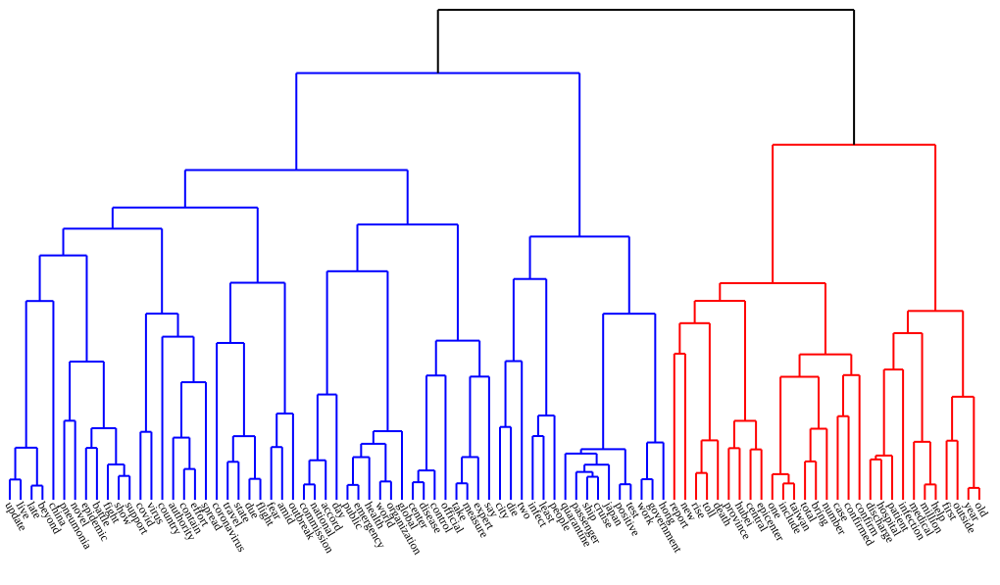

In [152]:
names = list(G_reduced.nodes)
image = svg_dendrogram(dendrogram, names, n_clusters=2, rotate=False,width=1000,height=500,filename='community_dendogram2'+period)
SVG(image)

**Metrics**

In [140]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=2, return_dendrogram=False))

community_dend = [[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [141]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.6195426195426196
Performance:  0.5278401997503122
Modularity:  0.132139935899106


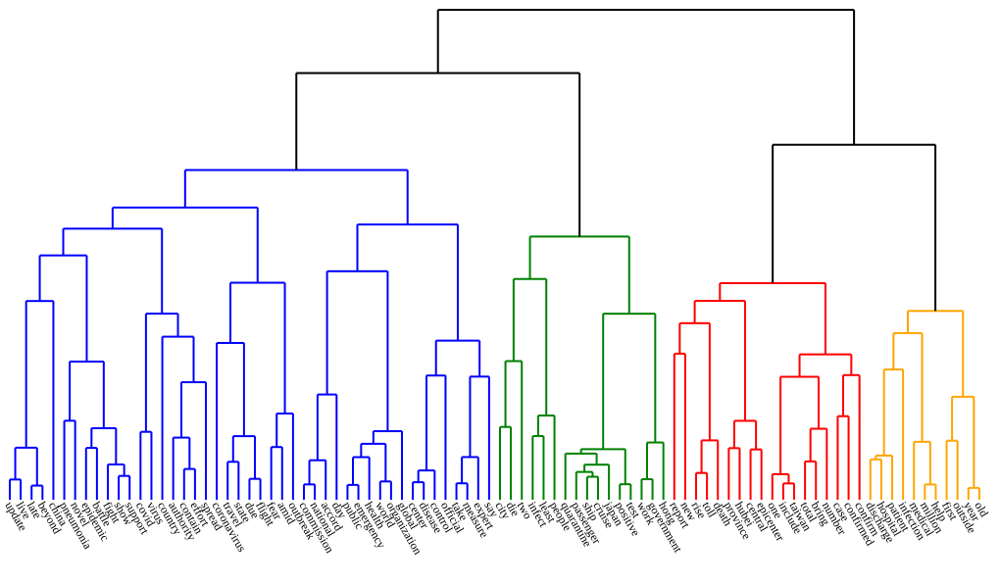

In [151]:
image = svg_dendrogram(dendrogram, names, n_clusters=4, rotate=False,width=1000,height=500,filename='community_dendogram4'+period)
SVG(image)

**Metrics**

In [144]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=4, return_dendrogram=False))

community_dend = [[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [145]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.4227304227304227
Performance:  0.6152309612983771
Modularity:  0.15822609632465365


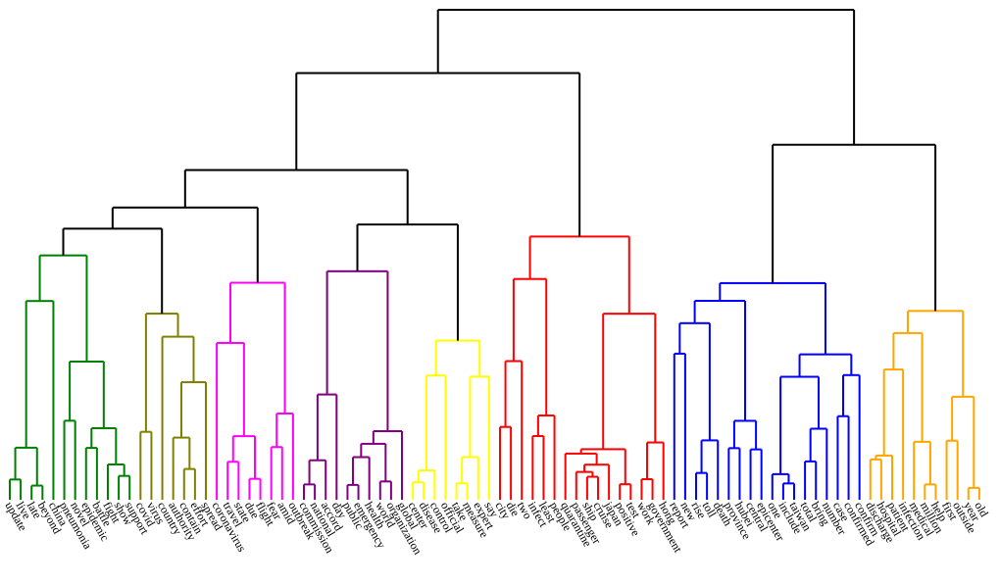

In [150]:
image = svg_dendrogram(dendrogram, names, n_clusters=8, rotate=False,width=1000,height=500,filename='community_dendogram8'+period)
SVG(image)

**Metrics**

In [153]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=8, return_dendrogram=False))

community_dend = [[],[],[],[],[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [154]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.22314622314622315
Performance:  0.6716604244694132
Modularity:  0.1306378372261413


## **SeptOct2020**

### Download data

In [175]:
period = '_SeptOct2020'
China = pd.read_csv('/content/China'+period+'.csv')
USA = pd.read_csv('/content/USA'+period+'.csv',)

edges = pd.read_csv('/content/edgelist_China_USA'+period+'.csv')
edges_China = pd.read_csv('/content/edgelist_China'+period+'.csv')
edges_USA = pd.read_csv('/content/edgelist_USA'+period+'.csv')

text_China = extract_text(China)
text_USA = extract_text(USA)

freq_dict_China = frequency_dictionary(text_China)
freq_dict_China = dict(sorted(freq_dict_China.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

freq_dict_USA = frequency_dictionary(text_USA)
freq_dict_USA = dict(sorted(freq_dict_USA.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

net, net_df = network_from_edges(edges)
net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G = get_graph(net)
nodes = G.nodes()
G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [176]:
print('China&USA:')
print('Nodes: ',len(G.nodes()))
print('Edges: ',len(G.edges()))
print('Is connected: ',nx.is_connected(G))
print()
print('China:')
print('Words: ',len(freq_dict_China))
print()
print('USA:')
print('Words: ',len(freq_dict_USA))

China&USA:
Nodes:  507
Edges:  5778
Is connected:  True

China:
Words:  6223

USA:
Words:  19469


In [177]:
# PageRank for reducing the graph
pr = nx.algorithms.pagerank(G, alpha = 1)
pr = dict(sorted(pr.items(), key=lambda item: item[1],reverse = True))

thr = 0.002
len(threshold(pr,thr))

80

In [178]:
G_reduced = G.copy()
nodes_to_delete = list(threshold_reverse(pr,thr)[0])
for n in nodes_to_delete:
    G_reduced.remove_node(n)

nx.is_connected(G_reduced)

True

### Bipartition
Partition a graph into two blocks using the Kernighan–Lin algorithm.

In [179]:
community_bipart = community.kernighan_lin_bisection(G,weight='weight')

In [180]:
print(community_bipart[0])
print(community_bipart[1])

{'promise', 'already', 'holiday', 'talk', 'commission', 'order', 'nationwide', 'jersey', 'seven', 'crisis', 'firm', 'service', 'hard', 'meet', 'development', 'season', 'korea', 'region', 'real', 'congress', 'several', 'within', 'trail', 'push', 'happen', 'trillion', 'decline', 'compare', 'side', 'likely', 'effort', 'stop', 'family', 'senate', 'also', 'winter', 'senator', 'possible', 'ask', 'watch', 'stimulus', 'british', 'mayor', 'severe', 'breaking', 'expose', 'outside', 'term', 'post', 'third', 'previous', 'six', 'aid', 'business', 'loss', 'way', 'air', 'update', 'protocol', 'life', 'slow', 'try', 'boost', 'italy', 'employee', 'stock', 'impose', 'urge', 'major', 'small', 'germany', 'package', 'court', 'full', 'restaurant', 'experience', 'control', 'poll', 'age', 'add', 'protest', 'stay', 'federal', 'ahead', 'secretary', 'recent', 'person', 'sen', 'voter', 'delay', 'market', 'task', 'win', 'free', 'nine', 'prevent', 'place', 'like', 'member', 'young', 'support', 'long', 'relief', 'kee

In [181]:
threshold = 0.00001
sum_China_0, sum_USA_0, sum_China_USA_0 = community_check(community_bipart[0], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
sum_China_1, sum_USA_1, sum_China_USA_1 = community_check(community_bipart[1], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)

In [182]:
print('First community:')
print('China: ', round(100 * sum_China_0 / len(community_bipart[0])),'%')
print('USA: ', round(100 * sum_USA_0 / len(community_bipart[0])),'%')
print('China&USA: ', round(100 * sum_China_USA_0 / len(community_bipart[0])),'%')
print()
print('China: ', round(100 * sum_China_1 / len(community_bipart[1])),'%')
print('USA: ', round(100 * sum_USA_1 / len(community_bipart[1])),'%')
print('China&USA: ', round(100 * sum_China_USA_1 / len(community_bipart[1])),'%')

First community:
China:  30 %
USA:  64 %
China&USA:  6 %

China:  38 %
USA:  57 %
China&USA:  5 %


**Metrics**

In [183]:
_ = compute_metrics(G, community_bipart)

Coverage:  0.7152994115610938
Performance:  0.5203826274060388
Modularity:  0.001856112170549963


### Modularity-based communities
Find communities in G using greedy modularity maximization.

In [184]:
community_mod = community.greedy_modularity_communities(G, n_communities=2, weight='weight')
# communities_naive_mod = community.naive_greedy_modularity_communities(G)

In [185]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['promise', 'food', 'authorization', 'experimental', 'firm', 'service', 'meet', 'fight', 'development', 'season', 'real', 'push', 'back', 'trial', 'likely', 'compare', 'side', 'possible', 'british', 'severe', 'adult', 'join', 'drug', 'russia', 'term', 'third', 'loss', 'try', 'protocol', 'life', 'boost', 'employee', 'plan', 'may', 'want', 'full', 'find', 'age', 'protest', 'get', 'risk', 'rule', 'antibody', 'part', 'help', 'exclusive', 'delay', 'market', 'johnson', 'follow', 'win', 'free', 'news', 'young', 'support', 'like', 'long', 'become', 'study', 'open', 'system', 'infect', 'financial', 'effective', 'seek', 'deal', 'make', 'party', 'gathering', 'group', 'facility', 'clear', 'available', 'potential', 'battle', 'two', 'candidate', 'stage', 'researcher', 'shot', 'industry', 'clinical', 'woman', 'result', 'illness', 'dose', 'end', 'soon', 'show', 'pause', 'immune', 'work', 'race', 'response', 'develop', 'late', 'strong', 'coverage', 'vaccine', 'need', 'billion', 'produce', 'right', 'off

In [186]:
threshold = 0.00001
for i in range(len(community_mod_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_mod_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_mod_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_mod_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_mod_list[i])),'%')
  print()

Community:  0
China:  23 %
USA:  71 %
China&USA:  6 %

Community:  1
China:  31 %
USA:  64 %
China&USA:  5 %

Community:  2
China:  50 %
USA:  45 %
China&USA:  6 %

Community:  3
China:  50 %
USA:  50 %
China&USA:  0 %

Community:  4
China:  25 %
USA:  75 %
China&USA:  0 %

Community:  5
China:  0 %
USA:  100 %
China&USA:  0 %



**Metrics**

In [187]:
_ = compute_metrics(G, community_mod_list)

Coverage:  0.5411907234337141
Performance:  0.691707400737501
Modularity:  0.22655682792177387


In [188]:
colors = list(G.nodes)
i = 0
dict_nodes = {}
for node in colors:
  if node in community_mod_list[0]:
    colors[i] = 'violet'
    dict_nodes[node] = 0
  if node in community_mod_list[1]:
    colors[i] = 'lightcoral'
    dict_nodes[node] = 1
  if node in community_mod_list[2]:
    colors[i] = 'lawngreen'
    dict_nodes[node] = 2
  if node in community_mod_list[3]:
    colors[i] = 'cyan'
    dict_nodes[node] = 3
  if node in community_mod_list[4]:
    colors[i] = 'dodgerblue'
    dict_nodes[node] = 4
  if node in community_mod_list[5]:
    colors[i] = 'yellow'
    dict_nodes[node] = 5
  i += 1

In [ ]:
pos = community_layout(G, dict_nodes)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Louvain Community Detection
Find the best partition of a graph using the Louvain Community Detection Algorithm.

In [194]:
# communities_louvain = community.louvain.louvain_communities(G)
# partitions_louvain = community.louvain.louvain_partitions(G)

community_louv = community_louvain.best_partition(G,weight='weight')

# modularity_louvain = community.modularity(communities_louvain, G) # ERROR: not a partition
# print("The modularity Q based on networkx is {}".format(modularity_louvain))

In [195]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['daily', 'case', 'coronavirus', 'infection', 'high', 'since', 'number', 'new', 'hit', 'record', 'italy', 'week', 'report', 'health', 'time', 'increase', 'death', 'month', 'country', 'rise', 'france', 'see', 'expert', 'surpass', 'million', 'toll', 'confirm', 'one', 'resurgence', 'accord', 'ministry', 'register', 'national', 'student', 'university', 'local', 'across', 'pass', 'second', 'wave', 'surge', 'close', 'government', 'bring', 'total', 'tally', 'india', 'brazil', 'winter', 'could', 'milestone', 'outbreak', 'spread', 'measure', 'past', 'hour', 'city', 'day', 'state', 'set', 'york', 'qingdao', 'last', 'united', 'fall', 'germany', 'start', 'spike', 'two', 'authority', 'six', 'school', 'region', 'minister', 'restriction', 'seven', 'nine', 'nationwide', 'three', 'decline', 'five', 'nearly', 'bar', 'rate', 'australia', 'low', 'impose', 'level', 'ease', 'another', 'warn', 'half', 'curb', 'force', 'almost', 'research', 'trend', 'slow', 'federal', 'task', 'prime', 'novel', 'worry', 'home'

In [196]:
threshold = 0.00001
for i in range(len(community_louvain_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_louvain_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_louvain_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_louvain_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_louvain_list[i])),'%')
  print()

Community:  0
China:  51 %
USA:  43 %
China&USA:  6 %

Community:  1
China:  28 %
USA:  67 %
China&USA:  5 %

Community:  2
China:  26 %
USA:  71 %
China&USA:  4 %

Community:  3
China:  32 %
USA:  62 %
China&USA:  6 %



**Metrics**

In [197]:
_ = compute_metrics(G, community_louvain_list)

Coverage:  0.49359640013845624
Performance:  0.735840525138184
Modularity:  0.22766493472703386


In [198]:
colors = list(community_louv.values())

colors[:] = [x if x != 0 else 'violet' for x in colors]
colors[:] = [x if x != 1 else 'dodgerblue' for x in colors]
colors[:] = [x if x != 2 else 'lawngreen' for x in colors]
colors[:] = [x if x != 3 else 'lightcoral' for x in colors]

In [ ]:
pos = community_layout(G, community_louv)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Dendogram

In [203]:
paris = Paris()
adjacency = nx.convert_matrix.to_numpy_array(G_reduced, nodelist = list(G_reduced.nodes))
dendrogram = paris.fit_transform(adjacency)

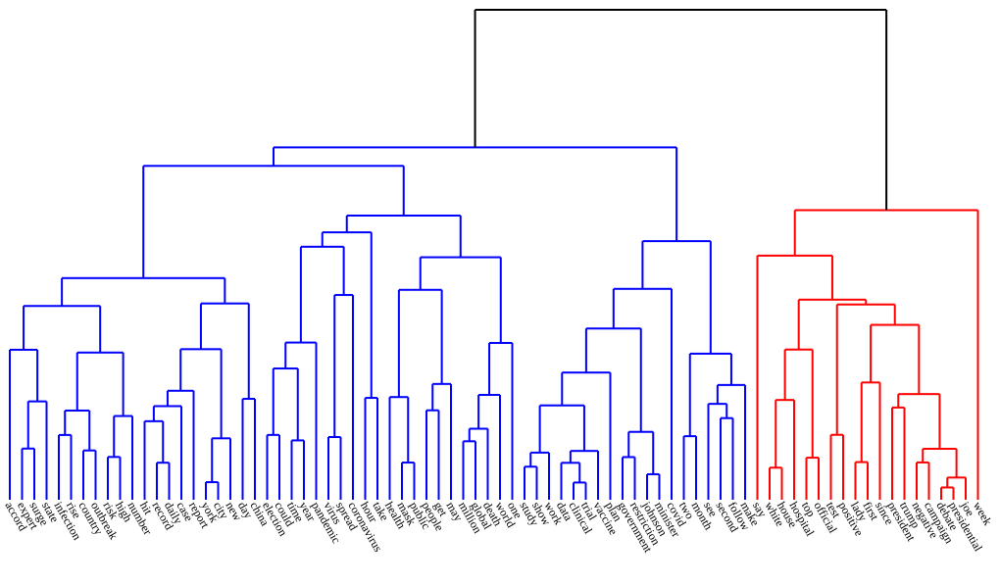

In [204]:
names = list(G_reduced.nodes)
image = svg_dendrogram(dendrogram, names, n_clusters=2, rotate=False,width=1000,height=500,filename='community_dendogram2'+period)
SVG(image)

**Metrics**

In [207]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=2, return_dendrogram=False))

community_dend = [[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [208]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.6792945787067276
Performance:  0.540506329113924
Modularity:  0.1380670460297657


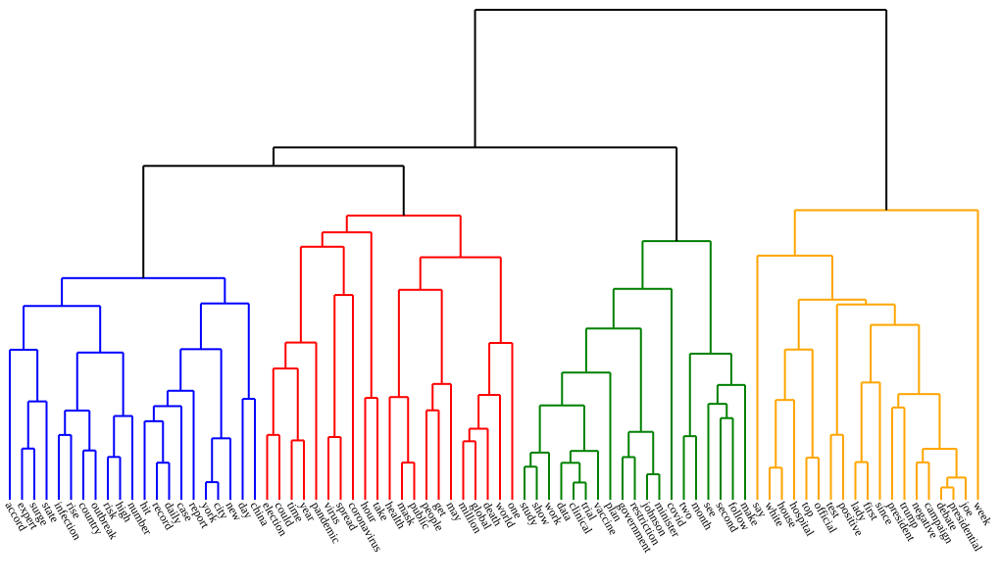

In [209]:
image = svg_dendrogram(dendrogram, names, n_clusters=4, rotate=False,width=1000,height=500,filename='community_dendogram4'+period)
SVG(image)

**Metrics**

In [210]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=4, return_dendrogram=False))

community_dend = [[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [211]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.3246244284781189
Performance:  0.5889240506329114
Modularity:  0.15093974320376569


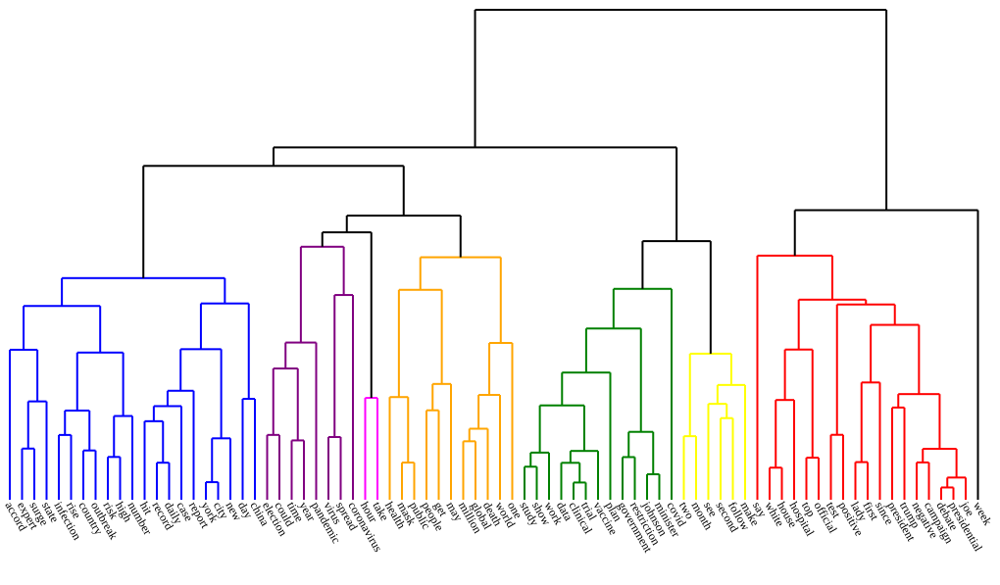

In [212]:
image = svg_dendrogram(dendrogram, names, n_clusters=8, rotate=False,width=1000,height=500,filename='community_dendogram8'+period)
SVG(image)

**Metrics**

In [213]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=8, return_dendrogram=False))

community_dend = [[],[],[],[],[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [214]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.24689745264532986
Performance:  0.5838607594936709
Modularity:  0.14080477540578754


## **MarchApril2021**

### Download data

In [215]:
period = '_MarchApril2021'
China = pd.read_csv('/content/China'+period+'.csv')
USA = pd.read_csv('/content/USA'+period+'.csv',)

edges = pd.read_csv('/content/edgelist_China_USA'+period+'.csv')
edges_China = pd.read_csv('/content/edgelist_China'+period+'.csv')
edges_USA = pd.read_csv('/content/edgelist_USA'+period+'.csv')

text_China = extract_text(China)
text_USA = extract_text(USA)

freq_dict_China = frequency_dictionary(text_China)
freq_dict_China = dict(sorted(freq_dict_China.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

freq_dict_USA = frequency_dictionary(text_USA)
freq_dict_USA = dict(sorted(freq_dict_USA.items(), key=lambda item: item[1], reverse = True))   #order from more frequent to less frequent word

net, net_df = network_from_edges(edges)
net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G = get_graph(net)
nodes = G.nodes()
G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [216]:
print('China&USA:')
print('Nodes: ',len(G.nodes()))
print('Edges: ',len(G.edges()))
print('Is connected: ',nx.is_connected(G))
print()
print('China:')
print('Words: ',len(freq_dict_China))
print()
print('USA:')
print('Words: ',len(freq_dict_USA))

China&USA:
Nodes:  499
Edges:  3051
Is connected:  True

China:
Words:  5858

USA:
Words:  12540


In [220]:
# PageRank for reducing the graph
pr = nx.algorithms.pagerank(G, alpha = 1)
pr = dict(sorted(pr.items(), key=lambda item: item[1],reverse = True))

thr = 0.002
len(threshold(pr,thr))

84

In [221]:
G_reduced = G.copy()
nodes_to_delete = list(threshold_reverse(pr,thr)[0])
for n in nodes_to_delete:
    G_reduced.remove_node(n)

nx.is_connected(G_reduced)

True

### Bipartition
Partition a graph into two blocks using the Kernighan–Lin algorithm.

In [222]:
community_bipart = community.kernighan_lin_bisection(G,weight='weight')

In [223]:
print(community_bipart[0])
print(community_bipart[1])

{'fall', 'joe', 'quarter', 'come', 'food', 'authorization', 'talk', 'economy', 'order', 'tokyo', 'write', 'crisis', 'seven', 'decide', 'service', 'past', 'hard', 'mark', 'site', 'foreign', 'hope', 'longer', 'hospitalization', 'crowd', 'recover', 'region', 'several', 'within', 'push', 'likely', 'decline', 'detect', 'effort', 'family', 'extend', 'california', 'also', 'inoculation', 'watch', 'british', 'authority', 'breaking', 'growth', 'join', 'affect', 'area', 'line', 'business', 'slow', 'game', 'level', 'forward', 'life', 'boost', 'reason', 'every', 'impose', 'hop', 'visit', 'major', 'want', 'community', 'small', 'full', 'experience', 'add', 'hold', 'former', 'die', 'fear', 'ahead', 'military', 'rule', 'place', 'antibody', 'step', 'part', 'recent', 'person', 'exclusive', 'governor', 'mask', 'secretary', 'threat', 'massive', 'passport', 'win', 'access', 'source', 'news', 'overseas', 'keep', 'support', 'like', 'beach', 'long', 'relief', 'member', 'great', 'tell', 'hong', 'well', 'claim',

In [224]:
threshold = 0.00001
sum_China_0, sum_USA_0, sum_China_USA_0 = community_check(community_bipart[0], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
sum_China_1, sum_USA_1, sum_China_USA_1 = community_check(community_bipart[1], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)

In [225]:
print('First community:')
print('China: ', round(100 * sum_China_0 / len(community_bipart[0])),'%')
print('USA: ', round(100 * sum_USA_0 / len(community_bipart[0])),'%')
print('China&USA: ', round(100 * sum_China_USA_0 / len(community_bipart[0])),'%')
print()
print('China: ', round(100 * sum_China_1 / len(community_bipart[1])),'%')
print('USA: ', round(100 * sum_USA_1 / len(community_bipart[1])),'%')
print('China&USA: ', round(100 * sum_China_USA_1 / len(community_bipart[1])),'%')

First community:
China:  29 %
USA:  65 %
China&USA:  5 %

China:  40 %
USA:  57 %
China&USA:  3 %


**Metrics**

In [226]:
_ = compute_metrics(G, community_bipart)

Coverage:  0.7862995739101933
Performance:  0.5150622530200964
Modularity:  3.6388078777526214e-05


### Modularity-based communities
Find communities in G using greedy modularity maximization.

In [227]:
community_mod = community.greedy_modularity_communities(G, n_communities=2, weight='weight')
# communities_naive_mod = community.naive_greedy_modularity_communities(G)

In [228]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['united', 'daily', 'quarter', 'food', 'talk', 'total', 'economy', 'tokyo', 'write', 'seven', 'crisis', 'service', 'past', 'hard', 'mark', 'longer', 'fight', 'crowd', 'death', 'recover', 'region', 'several', 'push', 'next', 'back', 'warn', 'bad', 'amid', 'effort', 'california', 'family', 'extend', 'intensive', 'nation', 'see', 'join', 'could', 'last', 'affect', 'area', 'close', 'line', 'third', 'business', 'level', 'game', 'rate', 'life', 'update', 'province', 'every', 'impose', 'restriction', 'city', 'visit', 'major', 'community', 'full', 'three', 'travel', 'year', 'experience', 'spike', 'france', 'hold', 'die', 'fear', 'positive', 'ahead', 'rule', 'case', 'set', 'since', 'step', 'recent', 'begin', 'part', 'nearly', 'help', 'hit', 'massive', 'origin', 'news', 'place', 'double', 'like', 'overseas', 'member', 'beach', 'long', 'relief', 'great', 'claim', 'study', 'demand', 'increase', 'another', 'reopen', 'chile', 'open', 'public', 'system', 'lift', 'less', 'release', 'state', 'struggle'

In [229]:
threshold = 0.00001
for i in range(len(community_mod_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_mod_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_mod_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_mod_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_mod_list[i])),'%')
  print()

Community:  0
China:  37 %
USA:  55 %
China&USA:  7 %

Community:  1
China:  27 %
USA:  72 %
China&USA:  1 %

Community:  2
China:  54 %
USA:  43 %
China&USA:  1 %

Community:  3
China:  24 %
USA:  71 %
China&USA:  6 %

Community:  4
China:  0 %
USA:  100 %
China&USA:  0 %

Community:  5
China:  43 %
USA:  57 %
China&USA:  0 %

Community:  6
China:  0 %
USA:  100 %
China&USA:  0 %

Community:  7
China:  25 %
USA:  75 %
China&USA:  0 %



**Metrics**

In [230]:
_ = compute_metrics(G, community_mod_list)

Coverage:  0.5355621107833497
Performance:  0.6692501468801056
Modularity:  0.18340239688070412


In [231]:
colors = list(G.nodes)
i = 0
dict_nodes = {}
for node in colors:
  if node in community_mod_list[0]:
    colors[i] = 'violet'
    dict_nodes[node] = 0
  if node in community_mod_list[1]:
    colors[i] = 'lightcoral'
    dict_nodes[node] = 1
  if node in community_mod_list[2]:
    colors[i] = 'lawngreen'
    dict_nodes[node] = 2
  if node in community_mod_list[3]:
    colors[i] = 'cyan'
    dict_nodes[node] = 3
  if node in community_mod_list[4]:
    colors[i] = 'dodgerblue'
    dict_nodes[node] = 4
  if node in community_mod_list[5]:
    colors[i] = 'yellow'
    dict_nodes[node] = 5
  if node in community_mod_list[6]:
    colors[i] = 'pink'
    dict_nodes[node] = 6
  if node in community_mod_list[7]:
    colors[i] = 'orange'
    dict_nodes[node] = 7
  i += 1

In [ ]:
pos = community_layout(G, dict_nodes)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Louvain Community Detection
Find the best partition of a graph using the Louvain Community Detection Algorithm.

In [235]:
# communities_louvain = community.louvain.louvain_communities(G)
# partitions_louvain = community.louvain.louvain_partitions(G)

community_louv = community_louvain.best_partition(G,weight='weight')

# modularity_louvain = community.modularity(communities_louvain, G) # ERROR: not a partition
# print("The modularity Q based on networkx is {}".format(modularity_louvain))

In [236]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['death', 'toll', 'surpass', 'mark', 'rise', 'new', 'virus', 'brazil', 'number', 'report', 'coronavirus', 'case', 'month', 'record', 'daily', 'high', 'surge', 'variant', 'last', 'hit', 'hour', 'bad', 'day', 'time', 'total', 'set', 'see', 'state', 'week', 'infection', 'india', 'michigan', 'average', 'every', 'spike', 'three', 'study', 'province', 'five', 'overseas', 'united', 'strain', 'york', 'yunnan', 'single', 'origin', 'another', 'update', 'next', 'coverage']
['one', 'second', 'people', 'million', 'first', 'accord', 'receive', 'least', 'dose', 'dos', 'adult', 'population', 'get', 'vaccinate', 'announce', 'jab', 'administer', 'extra', 'take', 'make', 'vaccination', 'across', 'office', 'mass', 'two', 'site', 'end', 'canada', 'half', 'president', 'drive', 'thailand', 'university', 'nearly', 'detect', 'require', 'student', 'young', 'joe', 'eligible', 'way', 'decline', 'mask', 'goal', 'fully', 'among', 'free', 'send', 'come', 'target', 'fall', 'person']
['covid', 'third', 'wave', 'global

In [237]:
threshold = 0.00001
for i in range(len(community_louvain_list)):
  sum_China, sum_USA, sum_China_USA = community_check(community_louvain_list[i], freq_dict_China, freq_dict_USA, G_China, G_USA, threshold)
  print('Community: ', i)
  print('China: ', round(100 * sum_China / len(community_louvain_list[i])),'%')
  print('USA: ', round(100 * sum_USA / len(community_louvain_list[i])),'%')
  print('China&USA: ', round(100 * sum_China_USA / len(community_louvain_list[i])),'%')
  print()

Community:  0
China:  50 %
USA:  46 %
China&USA:  4 %

Community:  1
China:  38 %
USA:  58 %
China&USA:  2 %

Community:  2
China:  31 %
USA:  62 %
China&USA:  6 %

Community:  3
China:  67 %
USA:  33 %
China&USA:  0 %

Community:  4
China:  22 %
USA:  78 %
China&USA:  0 %

Community:  5
China:  33 %
USA:  65 %
China&USA:  2 %



**Metrics**

In [238]:
_ = compute_metrics(G, community_louvain_list)

Coverage:  0.43723369387086203
Performance:  0.7182396922358774
Modularity:  0.18119738488774773


In [245]:
colors = list(community_louv.values())

colors[:] = [x if x != 0 else 'violet' for x in colors]
colors[:] = [x if x != 1 else 'dodgerblue' for x in colors]
colors[:] = [x if x != 2 else 'lawngreen' for x in colors]
colors[:] = [x if x != 3 else 'pink' for x in colors]
colors[:] = [x if x != 4 else 'lightcoral' for x in colors]
colors[:] = [x if x != 5 else 'cyan' for x in colors]

In [ ]:
pos = community_layout(G, community_louv)
fig = plt.figure(1, figsize=(200, 80), dpi=60)
nx.draw_networkx(G, pos, node_color=colors, node_size=5000, with_labels=True,
                 font_size =50,width=0.05)
plt.show()

### Dendogram

In [247]:
paris = Paris()
adjacency = nx.convert_matrix.to_numpy_array(G_reduced, nodelist = list(G_reduced.nodes))
dendrogram = paris.fit_transform(adjacency)

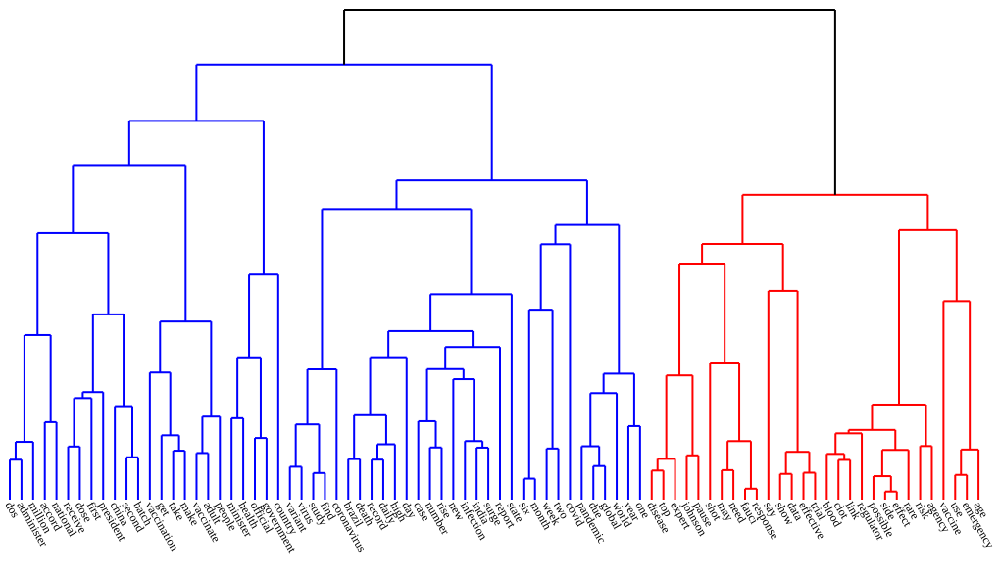

In [248]:
names = list(G_reduced.nodes)
image = svg_dendrogram(dendrogram, names, n_clusters=2, rotate=False,width=1000,height=500,filename='community_dendogram2'+period)
SVG(image)

**Metrics**

In [249]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=2, return_dendrogram=False))

community_dend = [[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [250]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.6991228070175438
Performance:  0.5877796901893287
Modularity:  0.1046402013936725


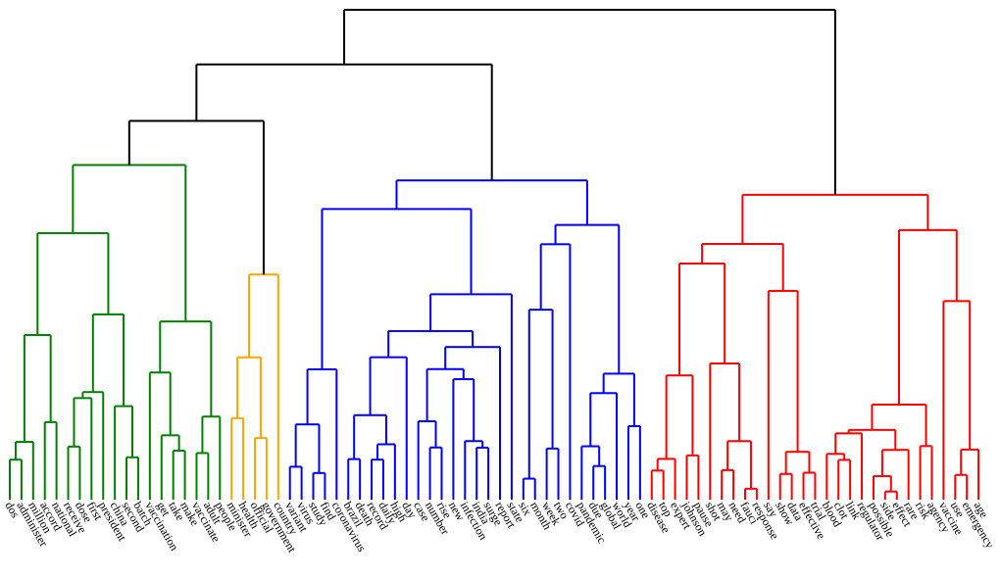

In [251]:
image = svg_dendrogram(dendrogram, names, n_clusters=4, rotate=False,width=1000,height=500,filename='community_dendogram4'+period)
SVG(image)

**Metrics**

In [252]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=4, return_dendrogram=False))

community_dend = [[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [253]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.45087719298245615
Performance:  0.6660929432013769
Modularity:  0.13051290119955758


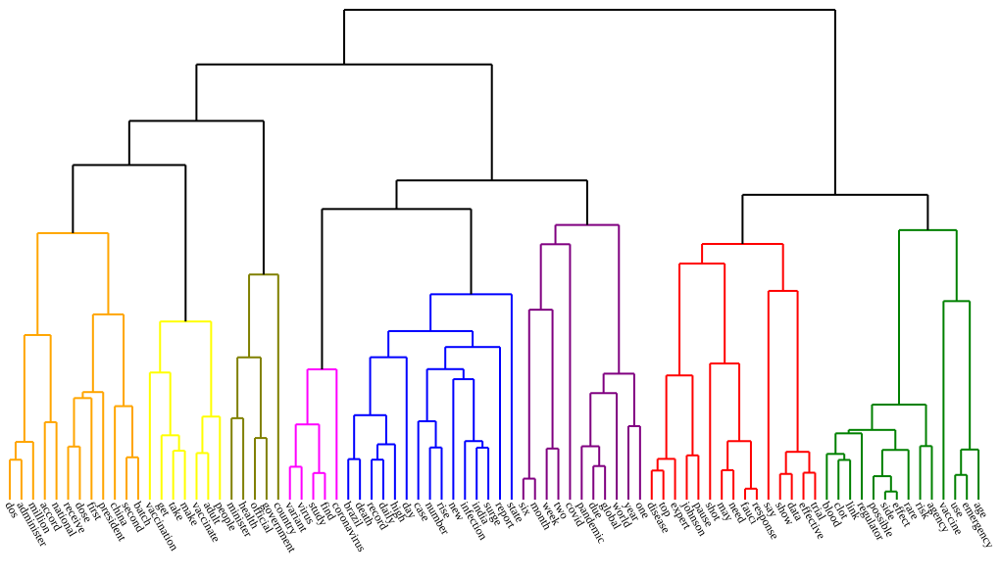

In [254]:
image = svg_dendrogram(dendrogram, names, n_clusters=8, rotate=False,width=1000,height=500,filename='community_dendogram8'+period)
SVG(image)

**Metrics**

In [255]:
nodelist = list(G_reduced.nodes)
labels = list(cut_straight(dendrogram, n_clusters=8, return_dendrogram=False))

community_dend = [[],[],[],[],[],[],[],[]]
i = 0
for node in nodelist:
  community_dend[labels[i]].append(node)
  i += 1

In [256]:
_ = compute_metrics(G_reduced, community_dend)

Coverage:  0.2710526315789474
Performance:  0.7174411933448078
Modularity:  0.09656077163325923


# PageRank Networks: inside/outside separate

## **All periods**

### Download data

In [80]:
edges_China = pd.read_csv('/content/edgelist_China.csv')
edges_USA = pd.read_csv('/content/edgelist_USA.csv')

net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [81]:
for c in nx.connected_components(G_China):
  print(c)

{'brazil', 'business', 'update', 'trial', 'city', 'governor', 'situation', 'read', 'trade', 'check', 'treat', 'service', 'anti', 'economy', 'india', 'curb', 'clinical', 'prevention', 'resident', 'south', 'cite', 'region', 'vaccinate', 'across', 'confidence', 'story', 'rate', 'wave', 'reporter', 'global', 'tell', 'commission', 'support', 'release', 'big', 'surge', 'york', 'office', 'emergency', 'next', 'holiday', 'percent', 'concern', 'measure', 'hubei', 'construction', 'self', 'good', 'detect', 'population', 'combat', 'party', 'period', 'end', 'offer', 'model', 'mark', 'expert', 'yunnan', 'symptom', 'expect', 'result', 'qingdao', 'donate', 'use', 'call', 'hard', 'plasma', 'amid', 'together', 'medic', 'tourist', 'positive', 'stay', 'confident', 'korea', 'staff', 'campaign', 'clot', 'far', 'recovery', 'past', 'four', 'launch', 'register', 'virus', 'agency', 'begin', 'case', 'level', 'house', 'life', 'video', 'tourism', 'post', 'child', 'doctor', 'top', 'student', 'warn', 'reopen', 'say',

In [82]:
G_China.remove_node('non')
G_China.remove_node('essential')

In [83]:
print('China:')
print('Nodes: ',len(G_China.nodes()))
print('Edges: ',len(G_China.edges()))
print('Is connected: ',nx.is_connected(G_China))
print()
print('USA:')
print('Nodes: ',len(G_USA.nodes()))
print('Edges: ',len(G_USA.edges()))
print('Is connected: ',nx.is_connected(G_USA))
print()

China:
Nodes:  444
Edges:  3118
Is connected:  True

USA:
Nodes:  521
Edges:  8969
Is connected:  True



In [84]:
# PageRank for reducing the graph
pr_China = nx.algorithms.pagerank(G_China, alpha = 1)
pr_China = dict(sorted(pr_China.items(), key=lambda item: item[1],reverse = True))

thr_C = 0.001
print(len(threshold(pr_China,thr_C)))

pr_USA = nx.algorithms.pagerank(G_USA, alpha = 1)
pr_USA = dict(sorted(pr_USA.items(), key=lambda item: item[1],reverse = True))

thr_U = 0.0012
print(len(threshold(pr_USA,thr_U)))

151
151


In [85]:
G_reduced_China = G_China.copy()
nodes_to_delete = list(threshold_reverse(pr_China,thr_C)[0])
for n in nodes_to_delete:
    G_reduced_China.remove_node(n)

print(nx.is_connected(G_reduced_China))

G_reduced_USA = G_USA.copy()
nodes_to_delete = list(threshold_reverse(pr_USA,thr_U)[0])
for n in nodes_to_delete:
    G_reduced_USA.remove_node(n)

print(nx.is_connected(G_reduced_USA))

True
True


### Modularity-based communities

CHINA

In [86]:
community_mod = community.greedy_modularity_communities(G_reduced_China, n_communities=2, weight='weight')

In [87]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['use', 'national', 'brazil', 'organization', 'global', 'receive', 'world', 'call', 'house', 'commission', 'dos', 'health', 'data', 'approve', 'president', 'vaccine', 'positive', 'economy', 'ministry', 'arrive', 'risk', 'emergency', 'announce', 'pandemic', 'country', 'test', 'government', 'batch', 'million', 'second', 'vaccination', 'say', 'develop', 'first', 'clot', 'accord', 'covid', 'prime', 'dose', 'africa', 'johnson', 'get', 'find', 'register', 'state', 'administer', 'minister', 'white', 'due', 'trump', 'public', 'blood', 'donate']
['hit', 'beijing', 'update', 'worker', 'fight', 'city', 'express', 'contain', 'support', 'coronavirus', 'amid', 'foreign', 'china', 'official', 'novel', 'take', 'live', 'late', 'send', 'outbreak', 'time', 'pneumonia', 'supply', 'international', 'prevention', 'conference', 'cause', 'measure', 'control', 'help', 'medical', 'work', 'hold', 'epidemic', 'battle', 'across', 'virus', 'press', 'effort', 'make', 'center', 'spread', 'expert', 'medium', 'disease',

USA

In [88]:
community_mod = community.greedy_modularity_communities(G_reduced_USA, n_communities=2, weight='weight')

In [89]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['national', 'brazil', 'total', 'infect', 'hit', 'organization', 'case', 'update', 'global', 'world', 'day', 'number', 'health', 'city', 'japan', 'continue', 'authority', 'coronavirus', 'see', 'amid', 'big', 'china', 'surge', 'novel', 'new', 'record', 'york', 'close', 'around', 'rise', 'late', 'cruise', 'outbreak', 'high', 'confirm', 'increase', 'daily', 'set', 'india', 'country', 'warn', 'government', 'infection', 'death', 'fear', 'restriction', 'report', 'accord', 'toll', 'least', 'travel', 'virus', 'united', 'state', 'spread', 'ship', 'die', 'people']
['use', 'trial', 'receive', 'need', 'dos', 'data', 'know', 'australia', 'patient', 'drug', 'follow', 'early', 'vaccine', 'may', 'start', 'shot', 'study', 'response', 'risk', 'emergency', 'plan', 'clinical', 'million', 'second', 'vaccination', 'concern', 'south', 'help', 'clot', 'work', 'one', 'covid', 'dose', 'show', 'johnson', 'get', 'find', 'pause', 'back', 'end', 'rare', 'make', 'minister', 'due', 'wave', 'result', 'blood']
['house'

### Louvain Community Detection

CHINA

In [126]:
community_louv = community_louvain.best_partition(G_reduced_China,weight='weight')

In [127]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['china', 'novel', 'face', 'people', 'world', 'make', 'disease', 'take', 'health', 'organization', 'team', 'international', 'expert', 'country', 'prevention', 'medical', 'worker', 'across', 'coronavirus', 'outbreak', 'support', 'help', 'fight', 'express', 'contain', 'epidemic', 'supply', 'chief', 'give', 'say', 'effort', 'send', 'amid', 'virus', 'foreign', 'minister', 'mask', 'donate', 'show', 'official', 'control', 'work', 'combat', 'around', 'die', 'measure', 'leave', 'city', 'battle', 'win', 'beijing', 'pneumonia', 'global', 'see', 'spread', 'response', 'president', 'solidarity', 'leader', 'call', 'doctor', 'public', 'emergency', 'cause', 'curb', 'stay', 'strong', 'time', 'director', 'confidence', 'prevent', 'center', 'staff', 'xinhua', 'jinping', 'community', 'check', 'authority']
['medium', 'live', 'brief', 'late', 'hold', 'national', 'commission', 'update', 'development', 'press', 'conference']
['outside', 'confirm', 'case', 'central', 'epicenter', 'hubei', 'province', 'number', 

USA

In [128]:
community_louv = community_louvain.best_partition(G_reduced_USA,weight='weight')

In [129]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['coronavirus', 'could', 'china', 'outbreak', 'late', 'epidemic', 'update', 'die', 'warn', 'patient', 'drug', 'amid', 'spread', 'business', 'infection', 'hospital', 'hit', 'follow', 'economy', 'government', 'citizen', 'fear', 'risk', 'million', 'due', 'city', 'work', 'contain', 'president', 'hong', 'doctor', 'deadly', 'face', 'mask', 'help', 'vaccine', 'big', 'become', 'treat', 'around', 'travel', 'may', 'know', 'live', 'effort', 'illness', 'week', 'suspend', 'flight', 'stock', 'company', 'take', 'one', 'close', 'measure', 'epicenter', 'medium', 'apple', 'medical', 'man', 'show', 'impact', 'department', 'continue', 'include', 'across', 'united', 'state', 'high', 'market', 'treatment', 'beyond', 'spreading', 'development']
['disease', 'center', 'control', 'prevention']
['south', 'korea']
['bring', 'confirm', 'case', 'rise', 'hubei', 'province', 'death', 'first', 'report', 'three', 'total', 'number', 'new', 'toll', 'already', 'virus', 'second', 'record', 'outside', 'lunar', 'year', 'holi

## **JanFeb2020**

### Download data

In [94]:
period = '_JanFeb2020'
edges_China = pd.read_csv('/content/edgelist_China'+period+'.csv')
edges_USA = pd.read_csv('/content/edgelist_USA'+period+'.csv')

net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [95]:
for c in nx.connected_components(G_China):
  print(c)

{'alone', 'thank', 'total', 'become', 'infect', 'front', 'update', 'observation', 'xinhua', 'need', 'look', 'put', 'lead', 'express', 'city', 'robot', 'drug', 'foreign', 'china', 'opinion', 'situation', 'official', 'new', 'take', 'taiwan', 'close', 'around', 'rise', 'read', 'jinping', 'trade', 'live', 'check', 'treat', 'victory', 'wang', 'research', 'headline', 'traditional', 'economy', 'citizen', 'country', 'international', 'prevention', 'leader', 'curb', 'resident', 'clinical', 'face', 'chief', 'baby', 'build', 'military', 'month', 'figure', 'south', 'help', 'work', 'transmission', 'accord', 'region', 'group', 'miss', 'battle', 'acid', 'cure', 'mask', 'across', 'confidence', 'market', 'rate', 'disease', 'since', 'public', 'reporter', 'hit', 'organization', 'epicenter', 'worker', 'fight', 'global', 'tell', 'commission', 'wish', 'data', 'support', 'facility', 'coronavirus', 'love', 'authority', 'release', 'complete', 'win', 'hand', 'novel', 'nurse', 'strong', 'newly', 'vaccine', 'send'

In [96]:
G_China.remove_node('officer')
G_China.remove_node('police')
G_China.remove_node('billion')
G_China.remove_node('dollar')
G_China.remove_node('spring')
G_China.remove_node('festival')

In [97]:
print('China:')
print('Nodes: ',len(G_China.nodes()))
print('Edges: ',len(G_China.edges()))
print('Is connected: ',nx.is_connected(G_China))
print()
print('USA:')
print('Nodes: ',len(G_USA.nodes()))
print('Edges: ',len(G_USA.edges()))
print('Is connected: ',nx.is_connected(G_USA))
print()

China:
Nodes:  296
Edges:  1408
Is connected:  True

USA:
Nodes:  435
Edges:  1746
Is connected:  True



In [112]:
# PageRank for reducing the graph
pr_China = nx.algorithms.pagerank(G_China, alpha = 1)
pr_China = dict(sorted(pr_China.items(), key=lambda item: item[1],reverse = True))

thr_C = 0.00064
print(len(threshold(pr_China,thr_C)))

pr_USA = nx.algorithms.pagerank(G_USA, alpha = 1)
pr_USA = dict(sorted(pr_USA.items(), key=lambda item: item[1],reverse = True))

thr_U = 0.0008
print(len(threshold(pr_USA,thr_U)))

151
149


In [113]:
G_reduced_China = G_China.copy()
nodes_to_delete = list(threshold_reverse(pr_China,thr_C)[0])
for n in nodes_to_delete:
    G_reduced_China.remove_node(n)

print(nx.is_connected(G_reduced_China))

G_reduced_USA = G_USA.copy()
nodes_to_delete = list(threshold_reverse(pr_USA,thr_U)[0])
for n in nodes_to_delete:
    G_reduced_USA.remove_node(n)

print(nx.is_connected(G_reduced_USA))

True
True


### Modularity-based communities

CHINA

In [114]:
community_mod = community.greedy_modularity_communities(G_reduced_China, n_communities=2, weight='weight')

In [115]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['world', 'xinhua', 'call', 'city', 'express', 'contain', 'see', 'amid', 'foreign', 'china', 'jinping', 'take', 'around', 'check', 'time', 'stay', 'leader', 'curb', 'country', 'prevention', 'face', 'chief', 'staff', 'help', 'work', 'battle', 'mask', 'across', 'give', 'confidence', 'virus', 'effort', 'disease', 'people', 'show', 'brief', 'community', 'beijing', 'organization', 'worker', 'fight', 'support', 'solidarity', 'coronavirus', 'win', 'president', 'novel', 'strong', 'prevent', 'send', 'outbreak', 'doctor', 'response', 'supply', 'test', 'cause', 'director', 'measure', 'say', 'control', 'medical', 'team', 'leave', 'epidemic', 'combat', 'make', 'center', 'minister', 'spread', 'expert', 'medium', 'die', 'donate']
['total', 'level', 'case', 'update', 'epicenter', 'number', 'drop', 'japan', 'new', 'taiwan', 'central', 'bring', 'cruise', 'three', 'two', 'confirm', 'pneumonia', 'include', 'suspected', 'discharge', 'infection', 'death', 'quarantine', 'province', 'macao', 'hubei', 'report'

USA

In [116]:
community_mod = community.greedy_modularity_communities(G_reduced_USA, n_communities=2, weight='weight')

In [117]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['man', 'become', 'business', 'hong', 'city', 'contain', 'drug', 'patient', 'week', 'amid', 'take', 'close', 'illness', 'treat', 'deadly', 'may', 'economy', 'risk', 'citizen', 'stock', 'face', 'korea', 'south', 'help', 'work', 'could', 'mask', 'market', 'effort', 'show', 'hit', 'epicenter', 'continue', 'coronavirus', 'big', 'globally', 'early', 'vaccine', 'suspend', 'outbreak', 'doctor', 'high', 'department', 'flight', 'warn', 'infection', 'government', 'company', 'million', 'measure', 'fear', 'medical', 'hospital', 'treatment', 'leave', 'impact', 'epidemic', 'find', 'apple', 'travel', 'united', 'state', 'spread', 'due', 'medium', 'die']
['national', 'total', 'case', 'update', 'day', 'number', 'commission', 'know', 'authority', 'beyond', 'china', 'new', 'record', 'rise', 'follow', 'live', 'late', 'bring', 'development', 'human', 'spreading', 'three', 'confirm', 'include', 'country', 'holiday', 'death', 'second', 'province', 'first', 'hubei', 'report', 'year', 'outside', 'accord', 'luna

### Louvain Community Detection

CHINA

In [122]:
community_louv = community_louvain.best_partition(G_reduced_China,weight='weight')

In [123]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['health', 'international', 'live', 'brief', 'prevention', 'late', 'official', 'hold', 'control', 'national', 'commission', 'update', 'global', 'press', 'conference', 'public', 'emergency', 'authority']
['china', 'novel', 'face', 'people', 'medium', 'world', 'make', 'disease', 'take', 'organization', 'team', 'expert', 'country', 'medical', 'worker', 'across', 'coronavirus', 'outbreak', 'support', 'help', 'fight', 'express', 'contain', 'epidemic', 'supply', 'chief', 'give', 'say', 'effort', 'send', 'amid', 'virus', 'foreign', 'minister', 'mask', 'donate', 'show', 'work', 'combat', 'around', 'development', 'die', 'measure', 'leave', 'city', 'battle', 'win', 'beijing', 'pneumonia', 'see', 'spread', 'response', 'president', 'solidarity', 'leader', 'call', 'doctor', 'cause', 'curb', 'stay', 'strong', 'time', 'director', 'confidence', 'prevent', 'center', 'staff', 'xinhua', 'jinping', 'community', 'check']
['outside', 'confirm', 'case', 'central', 'epicenter', 'hubei', 'province', 'number', 

USA

In [124]:
community_louv = community_louvain.best_partition(G_reduced_USA,weight='weight')

In [125]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['coronavirus', 'could', 'china', 'outbreak', 'late', 'epidemic', 'update', 'die', 'warn', 'patient', 'drug', 'amid', 'three', 'spread', 'business', 'infection', 'hospital', 'hit', 'follow', 'economy', 'government', 'citizen', 'fear', 'risk', 'million', 'due', 'city', 'work', 'contain', 'president', 'hong', 'doctor', 'deadly', 'face', 'mask', 'help', 'vaccine', 'big', 'become', 'treat', 'around', 'travel', 'may', 'know', 'live', 'effort', 'illness', 'week', 'suspend', 'flight', 'stock', 'company', 'take', 'one', 'close', 'measure', 'epicenter', 'medium', 'apple', 'medical', 'man', 'show', 'impact', 'department', 'continue', 'across', 'united', 'state', 'high', 'market', 'treatment', 'beyond', 'spreading', 'development']
['world', 'say', 'concern', 'health', 'global', 'early', 'public', 'declare', 'emergency', 'official', 'organization', 'national', 'commission', 'day', 'accord', 'international']
['south', 'korea']
['disease', 'center', 'control', 'prevention']
['people', 'infect', 'eva

## **SeptOct2020**

### Download data

In [131]:
period = '_SeptOct2020'
edges_China = pd.read_csv('/content/edgelist_China'+period+'.csv')
edges_USA = pd.read_csv('/content/edgelist_USA'+period+'.csv')

net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [132]:
for c in nx.connected_components(G_China):
  print(c)

{'brazil', 'total', 'trial', 'xinhua', 'need', 'city', 'china', 'governor', 'official', 'new', 'take', 'jinping', 'rise', 'close', 'around', 'twitter', 'walter', 'live', 'economy', 'hour', 'india', 'risk', 'announce', 'country', 'international', 'clinical', 'prevention', 'face', 'develop', 'help', 'work', 'accord', 'cite', 'region', 'italy', 'across', 'wave', 'since', 'hit', 'organization', 'global', 'fight', 'commission', 'wish', 'support', 'continue', 'coronavirus', 'authority', 'sept', 'surge', 'locally', 'york', 'vaccine', 'transmit', 'send', 'bring', 'lady', 'outbreak', 'high', 'protection', 'pandemic', 'set', 'test', 'holiday', 'infection', 'secretary', 'negative', 'quarantine', 'medical', 'leave', 'covid', 'prime', 'reed', 'get', 'united', 'speedy', 'end', 'make', 'expert', 'medium', 'expect', 'qingdao', 'sar', 'national', 'day', 'number', 'world', 'call', 'surpass', 'hard', 'golden', 'dos', 'week', 'see', 'amid', 'record', 'reach', 'may', 'local', 'positive', 'time', 'ministry'

In [133]:
G_China.remove_node('billion')
G_China.remove_node('dollar')

In [135]:
print('China:')
print('Nodes: ',len(G_China.nodes()))
print('Edges: ',len(G_China.edges()))
print('Is connected: ',nx.is_connected(G_China))
print()
print('USA:')
print('Nodes: ',len(G_USA.nodes()))
print('Edges: ',len(G_USA.edges()))
print('Is connected: ',nx.is_connected(G_USA))
print()

China:
Nodes:  172
Edges:  560
Is connected:  True

USA:
Nodes:  512
Edges:  4967
Is connected:  True



In [151]:
# PageRank for reducing the graph
pr_China = nx.algorithms.pagerank(G_China, alpha = 1)
pr_China = dict(sorted(pr_China.items(), key=lambda item: item[1],reverse = True))

thr_C = 0.00051
print(len(threshold(pr_China,thr_C)))

pr_USA = nx.algorithms.pagerank(G_USA, alpha = 1)
pr_USA = dict(sorted(pr_USA.items(), key=lambda item: item[1],reverse = True))

thr_U = 0.00115
print(len(threshold(pr_USA,thr_U)))

155
151


In [152]:
G_reduced_China = G_China.copy()
nodes_to_delete = list(threshold_reverse(pr_China,thr_C)[0])
for n in nodes_to_delete:
    G_reduced_China.remove_node(n)

print(nx.is_connected(G_reduced_China))

G_reduced_USA = G_USA.copy()
nodes_to_delete = list(threshold_reverse(pr_USA,thr_U)[0])
for n in nodes_to_delete:
    G_reduced_USA.remove_node(n)

print(nx.is_connected(G_reduced_USA))

True
True


### Modularity-based communities

CHINA

In [153]:
community_mod = community.greedy_modularity_communities(G_reduced_China, n_communities=2, weight='weight')

In [154]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['trial', 'xinhua', 'need', 'world', 'call', 'hard', 'dos', 'golden', 'city', 'see', 'week', 'amid', 'china', 'close', 'around', 'live', 'reach', 'may', 'economy', 'two', 'study', 'international', 'clinical', 'face', 'second', 'help', 'work', 'far', 'recovery', 'university', 'economic', 'virus', 'wave', 'hit', 'organization', 'global', 'fight', 'support', 'continue', 'tourism', 'nation', 'york', 'import', 'post', 'vaccine', 'bring', 'development', 'top', 'response', 'include', 'pandemic', 'holiday', 'cause', 'restriction', 'year', 'covid', 'epidemic', 'get', 'find', 'united', 'end', 'state', 'make', 'due', 'general', 'expert', 'medium', 'qingdao']
['brazil', 'national', 'total', 'case', 'day', 'number', 'surpass', 'commission', 'health', 'authority', 'coronavirus', 'tally', 'surge', 'governor', 'official', 'locally', 'new', 'take', 'record', 'rise', 'transmit', 'local', 'outbreak', 'ministry', 'high', 'confirm', 'hour', 'daily', 'india', 'set', 'protection', 'announce', 'country', 'inf

USA

In [155]:
community_mod = community.greedy_modularity_communities(G_reduced_USA, n_communities=2, weight='weight')

In [156]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['aide', 'tell', 'diagnosis', 'house', 'deal', 'debate', 'presidential', 'return', 'election', 'official', 'president', 'nominee', 'take', 'aid', 'lady', 'positive', 'doctor', 'three', 'vice', 'talk', 'still', 'former', 'top', 'announce', 'test', 'speaker', 'negative', 'administration', 'face', 'military', 'chief', 'quarantine', 'say', 'staff', 'first', 'campaign', 'medical', 'hospital', 'public', 'treatment', 'relief', 'mask', 'democratic', 'virus', 'penny', 'bill', 'joe', 'mike', 'white', 'symptom', 'trump', 'since', 'hope']
['use', 'infect', 'trial', 'volunteer', 'need', 'news', 'know', 'data', 'coronavirus', 'drug', 'amid', 'experimental', 'follow', 'early', 'vaccine', 'late', 'may', 'two', 'study', 'response', 'emergency', 'plan', 'pandemic', 'clinical', 'exclusive', 'second', 'south', 'work', 'year', 'adult', 'would', 'prime', 'dose', 'antibody', 'johnson', 'get', 'potential', 'back', 'end', 'candidate', 'part', 'make', 'minister', 'want', 'due', 'old', 'wave', 'result', 'show']


### Louvain Community Detection

CHINA

In [157]:
community_louv = community_louvain.best_partition(G_reduced_China,weight='weight')

In [158]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['daily', 'case', 'coronavirus', 'infection', 'high', 'number', 'new', 'record', 'report', 'since', 'see', 'surpass', 'million', 'take', 'confirm', 'one', 'health', 'country', 'accord', 'ministry', 'register', 'overseas', 'national', 'commission', 'local', 'surge', 'official', 'total', 'confirmed', 'tally', 'rise', 'death', 'protection', 'past', 'hour', 'far', 'russia', 'authority', 'locally', 'transmit', 'sar', 'import', 'outbreak', 'spread', 'toll', 'york', 'set', 'italy', 'governor', 'india', 'brazil', 'cite']
['africa', 'center', 'reach', 'control', 'disease', 'prevention']
['watch', 'late', 'sept']
['first', 'announce', 'people', 'positive', 'say', 'test', 'minister', 'president', 'trump', 'white', 'house', 'time', 'nation', 'remain', 'jinping', 'presidential', 'prime', 'doctor', 'lady', 'walter', 'twitter', 'vice', 'reed', 'medical', 'wife', 'quarantine', 'joe', 'negative', 'hospital', 'diagnosis', 'wish']
['covid', 'week', 'pandemic', 'university', 'global', 'bring', 'world', 'c

USA

In [159]:
community_louv = community_louvain.best_partition(G_reduced_USA,weight='weight')

In [160]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['say', 'test', 'since', 'doctor', 'trump', 'negative', 'president', 'diagnosis', 'need', 'know', 'face', 'mask', 'hospital', 'white', 'house', 'treatment', 'military', 'positive', 'staff', 'official', 'virus', 'symptom', 'result', 'three', 'top', 'take', 'still', 'chief', 'announce', 'presidential', 'nominee', 'joe', 'election', 'administration', 'campaign', 'first', 'back', 'public', 'return', 'debate', 'democratic', 'tell', 'vice', 'mike', 'penny', 'medical', 'quarantine', 'aide', 'former', 'lady', 'hope']
['coronavirus', 'pandemic', 'plan', 'spread', 'amid', 'late', 'talk', 'close', 'year', 'relief', 'aid', 'end', 'south', 'bill', 'deal', 'speaker']
['vaccine', 'use', 'candidate', 'trial', 'news', 'follow', 'may', 'see', 'make', 'experimental', 'drug', 'work', 'study', 'response', 'emergency', 'infect', 'volunteer', 'clinical', 'get', 'due', 'antibody', 'two', 'show', 'want', 'johnson', 'potential', 'old', 'part', 'would', 'early', 'data', 'exclusive', 'adult', 'dose']
['global', '

## **MarchApril2021**

### Download data

In [161]:
period = '_MarchApril2021'
edges_China = pd.read_csv('/content/edgelist_China'+period+'.csv')
edges_USA = pd.read_csv('/content/edgelist_USA'+period+'.csv')

net_China, _ = network_from_edges(edges_China)
net_USA, _ = network_from_edges(edges_USA)

G_China = get_graph(net_China)
G_USA = get_graph(net_USA)

In [163]:
print('China:')
print('Nodes: ',len(G_China.nodes()))
print('Edges: ',len(G_China.edges()))
print('Is connected: ',nx.is_connected(G_China))
print()
print('USA:')
print('Nodes: ',len(G_USA.nodes()))
print('Edges: ',len(G_USA.edges()))
print('Is connected: ',nx.is_connected(G_USA))
print()

China:
Nodes:  216
Edges:  688
Is connected:  True

USA:
Nodes:  491
Edges:  2285
Is connected:  True



In [176]:
# PageRank for reducing the graph
pr_China = nx.algorithms.pagerank(G_China, alpha = 1)
pr_China = dict(sorted(pr_China.items(), key=lambda item: item[1],reverse = True))

thr_C = 0.00065
print(len(threshold(pr_China,thr_C)))

pr_USA = nx.algorithms.pagerank(G_USA, alpha = 1)
pr_USA = dict(sorted(pr_USA.items(), key=lambda item: item[1],reverse = True))

thr_U = 0.00099
print(len(threshold(pr_USA,thr_U)))

150
152


In [177]:
G_reduced_China = G_China.copy()
nodes_to_delete = list(threshold_reverse(pr_China,thr_C)[0])
for n in nodes_to_delete:
    G_reduced_China.remove_node(n)

print(nx.is_connected(G_reduced_China))

G_reduced_USA = G_USA.copy()
nodes_to_delete = list(threshold_reverse(pr_USA,thr_U)[0])
for n in nodes_to_delete:
    G_reduced_USA.remove_node(n)

print(nx.is_connected(G_reduced_USA))

True
True


### Modularity-based communities

CHINA

In [178]:
community_mod = community.greedy_modularity_communities(G_reduced_China, n_communities=2, weight='weight')

In [179]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['brazil', 'total', 'day', 'number', 'third', 'city', 'see', 'week', 'amid', 'last', 'new', 'record', 'local', 'positive', 'two', 'confirm', 'study', 'daily', 'origin', 'announce', 'michigan', 'chile', 'help', 'base', 'one', 'group', 'register', 'virus', 'since', 'show', 'hit', 'case', 'global', 'news', 'data', 'coronavirus', 'surge', 'locally', 'single', 'transmit', 'bring', 'institute', 'high', 'pandemic', 'watch', 'test', 'government', 'infection', 'reopen', 'death', 'province', 'variant', 'report', 'year', 'capital', 'covid', 'toll', 'find', 'end', 'overseas', 'state', 'due', 'expert', 'yunnan']
['use', 'beijing', 'receive', 'pharmaceutical', 'approve', 'foreign', 'china', 'hand', 'jab', 'president', 'purchase', 'live', 'vaccine', 'late', 'may', 'inoculate', 'start', 'animal', 'shot', 'three', 'arrive', 'emergency', 'country', 'international', 'effective', 'company', 'batch', 'second', 'vaccination', 'develop', 'first', 'campaign', 'shipment', 'african', 'russia', 'prime', 'dose', 

USA

In [180]:
community_mod = community.greedy_modularity_communities(G_reduced_USA, n_communities=2, weight='weight')

In [181]:
community_mod_list = []
for comm in community_mod:
 print(list(comm))
 community_mod_list.append(list(comm))

['use', 'possible', 'germany', 'trial', 'need', 'delay', 'health', 'blood', 'side', 'union', 'know', 'australia', 'drug', 'regulator', 'official', 'recommend', 'export', 'prevent', 'vaccine', 'many', 'may', 'age', 'outweigh', 'shot', 'top', 'risk', 'plan', 'emergency', 'supply', 'effective', 'government', 'symptomatic', 'company', 'benefit', 'concern', 'say', 'effect', 'clot', 'medicine', 'infectious', 'link', 'show', 'johnson', 'safe', 'six', 'find', 'pause', 'give', 'back', 'agency', 'rare', 'offer', 'minister', 'due', 'brain', 'expert', 'disease', 'efficacy', 'would']
['brazil', 'hit', 'case', 'update', 'france', 'day', 'number', 'world', 'third', 'data', 'coronavirus', 'patient', 'week', 'see', 'amid', 'china', 'surge', 'nation', 'president', 'new', 'record', 'rise', 'child', 'time', 'high', 'two', 'study', 'daily', 'india', 'set', 'country', 'test', 'infection', 'death', 'second', 'vaccination', 'month', 'first', 'south', 'work', 'restriction', 'hospital', 'report', 'variant', 'an

### Louvain Community Detection

CHINA

In [182]:
community_louv = community_louvain.best_partition(G_reduced_China,weight='weight')

In [183]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['death', 'covid', 'toll', 'brazil', 'number', 'report', 'case', 'record', 'daily', 'high', 'day', 'new', 'week', 'announce', 'government', 'total', 'data', 'see', 'pandemic', 'expert', 'virus', 'find', 'amid', 'third', 'authority', 'infection', 'group', 'hit', 'two', 'test', 'positive', 'end', 'show', 'year', 'capital', 'base', 'last', 'state', 'city', 'news', 'watch', 'confirm', 'reopen', 'since', 'surge', 'study', 'help', 'register', 'province', 'bring', 'overseas', 'live', 'institute', 'variant', 'chile', 'due', 'coronavirus', 'include', 'local', 'yunnan', 'campaign', 'single', 'origin', 'russia', 'pharmaceutical', 'michigan', 'locally', 'transmit']
['clinical', 'trial', 'phase']
['say', 'africa', 'control', 'south', 'side', 'center', 'disease', 'prevention', 'risk', 'blood', 'clot', 'effect', 'agency', 'possible', 'rare', 'link']
['million', 'people', 'administer', 'accord', 'health', 'vaccination', 'world', 'organization', 'across', 'dos', 'march', 'vaccinate', 'official', 'natio

USA

In [184]:
community_louv = community_louvain.best_partition(G_reduced_USA,weight='weight')

In [185]:
max = np.max(list(community_louv.values()))
community_louvain_list = []
for i in range(max+1):
  community_louvain_list.append([])
for key in list(community_louv.keys()):
  community_louvain_list[community_louv[key]].append(key)
for i in range(max+1):
  print(community_louvain_list[i])

['old', 'year', 'receive', 'people', 'least', 'back', 'way', 'make', 'urge', 'one', 'vaccinate', 'adult', 'get', 'population', 'university', 'among', 'take', 'end', 'dose', 'half']
['covid', 'state', 'month', 'india', 'new', 'daily', 'infection', 'high', 'report', 'case', 'two', 'first', 'study', 'since', 'restriction', 'brazil', 'variant', 'record', 'rise', 'accord', 'much', 'death', 'virus', 'south', 'wave', 'time', 'see', 'patient', 'day', 'third', 'hospital', 'vaccination', 'china', 'hit', 'week', 'surge', 'amid', 'number', 'test', 'set', 'second', 'france', 'work', 'analysis', 'nation', 'update', 'united']
['vaccine', 'say', 'six', 'trial', 'emergency', 'know', 'supply', 'risk', 'brain', 'blood', 'clot', 'disease', 'could', 'expert', 'effective', 'prevent', 'delay', 'help', 'use', 'child', 'due', 'government', 'show', 'many', 'johnson', 'shot', 'top', 'germany', 'find', 'may', 'medicine', 'regulator', 'possible', 'link', 'need', 'would', 'data', 'export', 'effect', 'australia', 'c